In [1]:
import time
import os
import sys
import math
import numpy as np
import cv2
import pandas as pd
import pyautogui as pa
from scipy.stats import binom_test
from matplotlib.markers import TICKDOWN
from matplotlib import rcParams
import datetime
from scipy.stats import norm, kstest, sem, ttest_ind
from numpy.polynomial import polynomial
import imageio
from scipy.fft import fft
from scipy.signal import coherence, correlate, csd
import networkx as nx

from lib.auto_GUI.auto_GUI_base import AutoGUIBase
from lib.auto_GUI.auto_PhotoZ import AutoPhotoZ
from lib.analysis.laminar_dist import *
from lib.file.ROI_reader import ROIFileReader
from lib.analysis.cell_roi import OverlapCounterROI
from lib.analysis.baseline_correction import BaselineCorrection

C:\Users\jjudge3\AppData\Roaming\Python\Python39\site-packages\matplotlib\projections\__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


In [2]:
data_dir = "C:/Users/jjudge3/Desktop/Data/mm_full_pipeline_targets/PPR_GABAzine/"
catalog_csv = data_dir + 'ppr_catalog_backup.csv'
export_csv = data_dir + 'export_summary_backup.csv'
single_file = data_dir + 'export_summary_single_px_single_trial.csv'

In [3]:
# load csv files
catalog_df = pd.read_csv(catalog_csv)
catalog_df = pd.DataFrame(catalog_df)
catalog_df

,zda_file,pulse1_start,pulse1_width,pulse2_start,pulse2_width,baseline_start,baseline_width,Notes,IPI
0,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,216,37,356.0,37.0,216,340,"ACSF, PPR",70
1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,216,37,NaN,NaN,216,200,"ACSF, control",70
2,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,116,37,356.0,37.0,116,440,"ACSF, PPR",120
3,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,316,37,NaN,NaN,316,200,"ACSF, control",20
4,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,316,37,356.0,37.0,316,240,"ACSF, PPR",20
5,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,116,37,356.0,37.0,116,440,"Gabazine, PPR",120
6,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,316,37,356.0,37.0,316,240,"Gabazine, PPR",20
7,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,316,37,NaN,NaN,316,200,"Gabazine, Control",20
8,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,216,37,NaN,NaN,216,200,"ACSF, Control",70
9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,216,37,356.0,37.0,216,340,"ACSF, PPR",70


In [4]:
export_df = pd.read_csv(export_csv)
export_df = pd.DataFrame(export_df)
export_df  # home barrels are ROI 1, neighbor barrels are ROI 2

# open single px single trial traces
single_df = pd.read_csv(single_file)
single_df = pd.DataFrame(single_df)
single_df

,ROI_File,ROI_Set,Date,Slice,Location,Recording,trace
0,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial1,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial2,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
2,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial3,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
3,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial4,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
4,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial5,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
...,...,...,...,...,...,...,...
285,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_2roisroi_rand_1 trial1,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
286,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_2roisroi_rand_1 trial2,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
287,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_2roisroi_rand_1 trial3,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...
288,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_2roisroi_rand_1 trial4,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...


In [5]:
# first, look up metadata in catalog_df and append to export_df
def read_dat_trace_file(filename):
    data_arr = pd.read_csv(filename,
                                 sep='\t',
                                 header=0)  # change me to traces?
    data_arr = data_arr.apply(pd.to_numeric, errors='coerce')
    return data_arr

def format_date(date, input_format="%m/%d/%Y", format="%m-%d-%y"):
    try:
        date = datetime.datetime.strptime(date, input_format)
        return date.strftime(format)
    except:
        return date

def format_zda(slic, loc, rec):
    """ pad to ss_ll_rr """
    slic = str(slic).zfill(2)
    loc = str(loc).zfill(2)
    rec = str(rec).zfill(2)
    return slic + '_' + loc + '_' + rec

for df in [export_df, single_df]:
    append_columns = {'ipi': [], 'drug' : [], 'num_pulses': [] }
    for index, row in df.iterrows():
        date = row['Date']    
        slic = row['Slice']
        location = row['Location']
        recording = row['Recording']
        file_formatted_date = format_date(date)
        zda_id = format_zda(row['Slice'], row['Location'], row['Recording'])

        # look up zda file in catalog
        zda_row = catalog_df.loc[(catalog_df['zda_file'].str.contains(file_formatted_date)) &
                                (catalog_df['zda_file'].str.contains(zda_id))]
        if len(zda_row) == 0:
            print(f"Could not find zda file for {file_formatted_date} {zda_id}")
            continue

        append_columns['ipi'].append(zda_row['IPI'].values[0])
        drug, num_pulses = zda_row['Notes'].values[0].split(',')
        append_columns['drug'].append(drug)
        append_columns['num_pulses'].append(num_pulses)

    # append columns to export_df
    for key, value in append_columns.items():
        df[key] = value
single_df

,ROI_File,ROI_Set,Date,Slice,Location,Recording,trace,ipi,drug,num_pulses
0,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial1,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial2,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
2,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial3,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
3,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial4,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
4,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial5,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
...,...,...,...,...,...,...,...,...,...,...
285,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_2roisroi_rand_1 trial1,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,120,Gabazine,Control
286,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_2roisroi_rand_1 trial2,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,120,Gabazine,Control
287,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_2roisroi_rand_1 trial3,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,120,Gabazine,Control
288,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_2roisroi_rand_1 trial4,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,120,Gabazine,Control


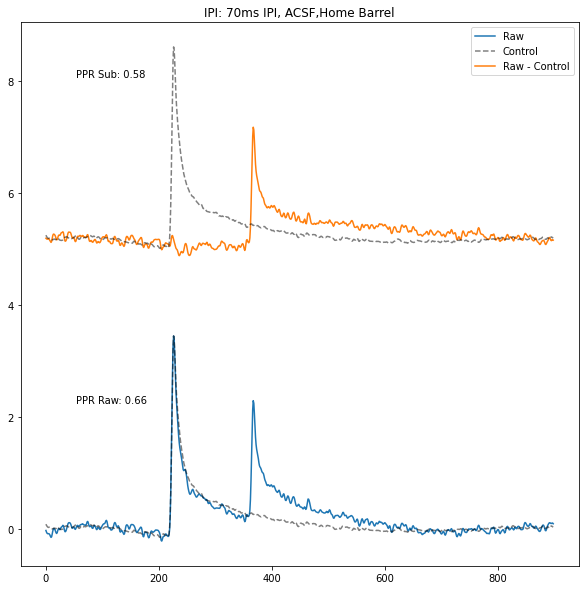

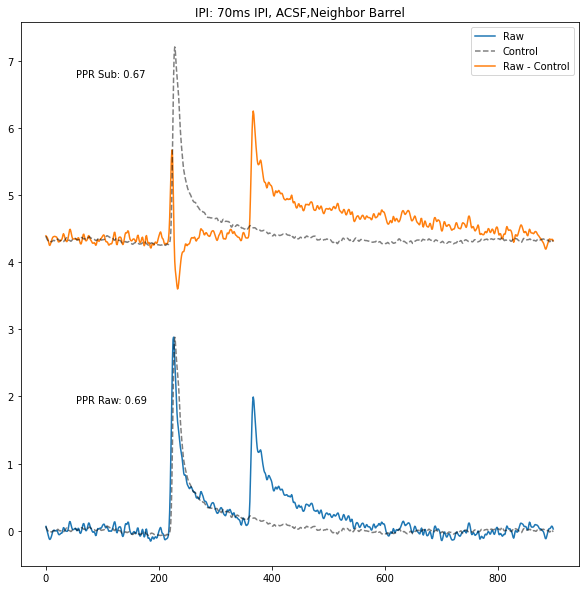

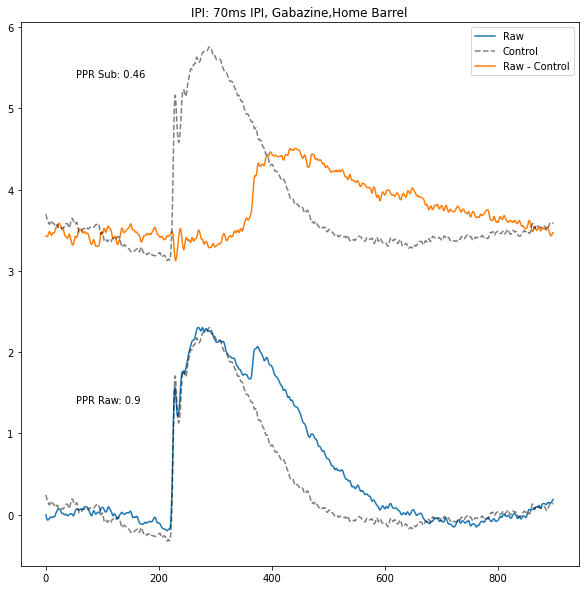

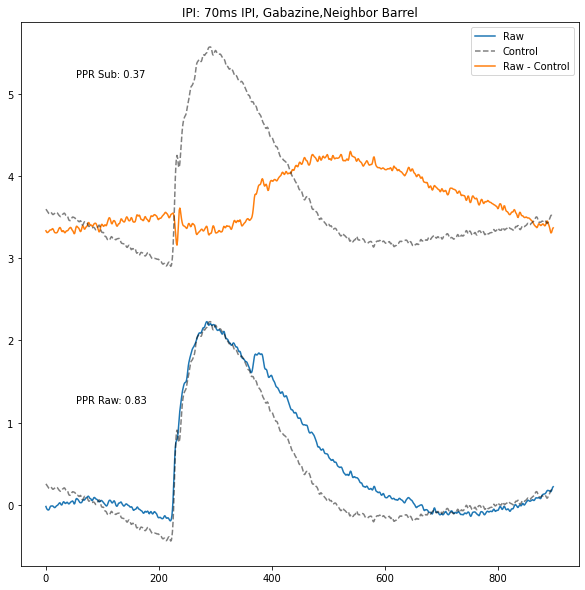

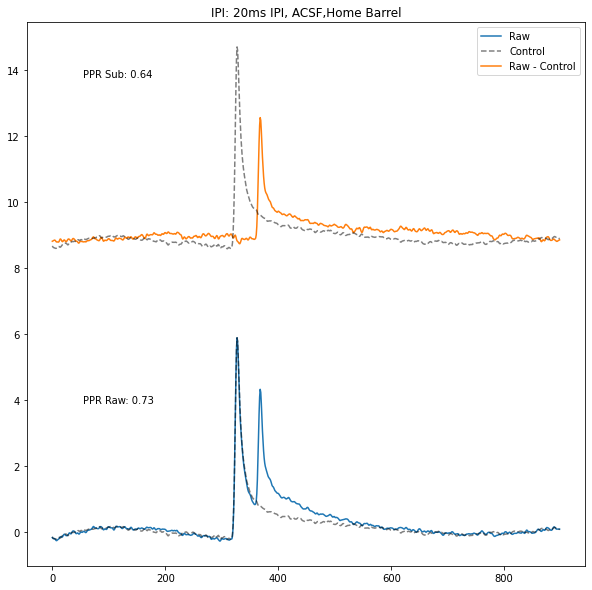

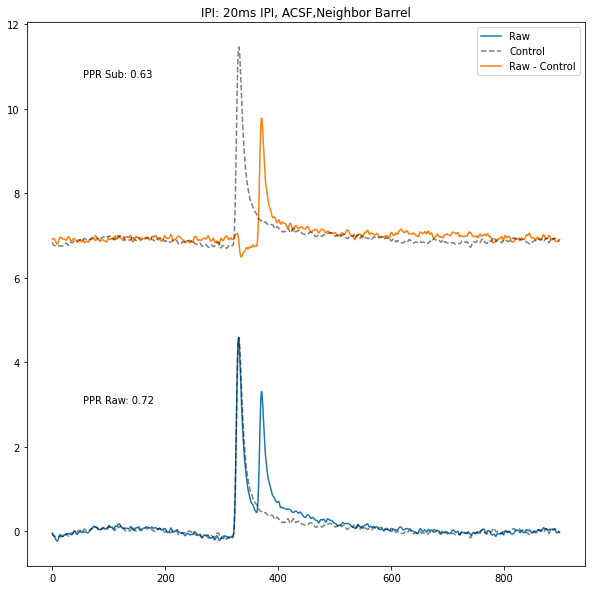

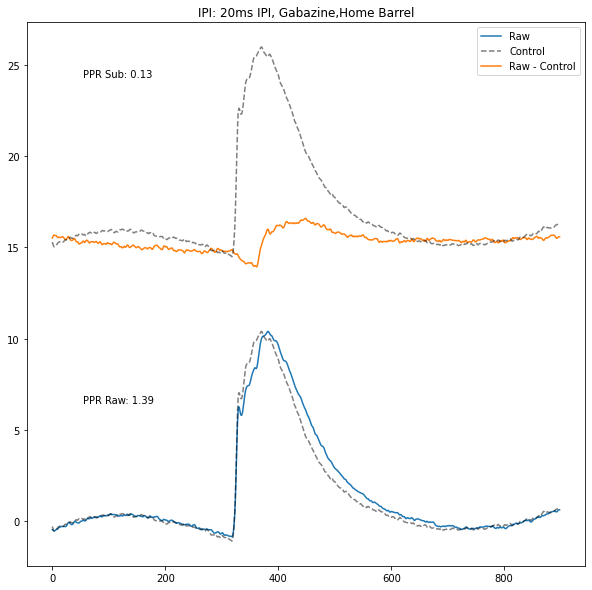

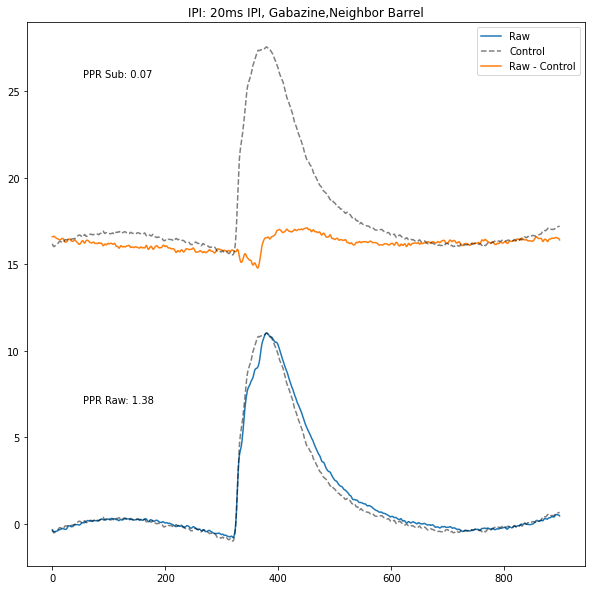

In [6]:
# for each ROI, load traces and perform summation decomposition by 
# subtracting the control trace from the paired-pulse trace.
# display the traces and the maxAmp arrays for each pulse
ppr = {}

for ipi in export_df['ipi'].unique():
    ipi_df = export_df[export_df['ipi'] == ipi]
    for drug in ipi_df['drug'].unique():
        drug_df = ipi_df[ipi_df['drug'] == drug]
        for roi in drug_df['ROI'].unique():
            roi_df = drug_df[drug_df['ROI'] == roi]
            roi_idx = 'ROI' + str(roi)
            
            ppr_row = roi_df[roi_df['num_pulses'].str.contains('PPR')]
            control_row = roi_df[roi_df['num_pulses'].str.contains('ontrol')]

            # load traces
            if ppr_row.empty or control_row.empty:
                continue
            ppr_trace = read_dat_trace_file(ppr_row['trace'].values[0])
            ppr_trace_non_polyfit = read_dat_trace_file(ppr_row['trace_non_polyfit'].values[0])
            control_trace = read_dat_trace_file(control_row['trace'].values[0])
            control_trace_non_polyfit = read_dat_trace_file(control_row['trace_non_polyfit'].values[0])

            # normalize the control traces to the max amp of the ppr traces
            control_trace_non_polyfit = control_trace_non_polyfit * (ppr_trace_non_polyfit.max() / control_trace_non_polyfit.max())
            control_trace = control_trace * (ppr_trace.max() / control_trace.max())

            trace_sub = ppr_trace_non_polyfit[roi_idx] - control_trace_non_polyfit[roi_idx]

            # calculate dist from zero of subtracted trace before second stim
            trace_sub_dist = trace_sub[(trace_sub.index < 356) | (trace_sub.index > 550)].abs().mean()
            if trace_sub_dist > 1:
                print('Warning: trace_sub_dist is greater than 1: ' + str(trace_sub_dist))
                continue

            # calculate maxAmp of subtracted trace in measure window (356 - 450)
            trace_sub_max = trace_sub[(trace_sub.index > 356) & (trace_sub.index < 450)].max()

            # calculate first and second maxAmp of raw trace in measure windows
            second_pulse_measure_window = [356, 450]
            first_pulse_measure_window = [116, 350]

            pulse1_raw_maxamp = ppr_trace[(ppr_trace.index > first_pulse_measure_window[0]) & 
                                          (ppr_trace.index < first_pulse_measure_window[1])][roi_idx].max()
            pulse2_raw_maxamp = ppr_trace[(ppr_trace.index > second_pulse_measure_window[0]) &
                                          (ppr_trace.index < second_pulse_measure_window[1])][roi_idx].max()

            ppr_raw = pulse2_raw_maxamp / pulse1_raw_maxamp
            ppr_sub = trace_sub_max / pulse1_raw_maxamp

            # show both traces and their subtraction (PPR - Control)
            fig, ax = plt.subplots(1, 1, figsize=(10, 10))
            roi_idx = 'ROI' + str(roi)
            ax.plot(ppr_trace['Pt'], ppr_trace[roi_idx], label='Raw')
            ax.plot(control_trace['Pt'], control_trace[roi_idx], 'k--', label='Control', alpha=0.5)
            ax.plot(ppr_trace['Pt'], 
                        trace_sub + np.max(control_trace[roi_idx]) * 1.5, 
                        label='Raw - Control')
            ax.plot(ppr_trace['Pt'], 
                        control_trace[roi_idx] + np.max(control_trace[roi_idx]) * 1.5, 'k--', 
                        alpha=0.5)
            ax.legend()
            # annotate with ppr_raw, ppr_sub, and trace_sub_dist
            ax.text(0.1, 0.3, 'PPR Raw: ' + str(round(ppr_raw,2)), transform=ax.transAxes)
            ax.text(0.1, 0.9, 'PPR Sub: ' + str(round(ppr_sub,2)), transform=ax.transAxes)
            ax.set_title('IPI: ' + str(ipi) + 'ms IPI, ' + drug + ',' + ("Home" if roi == 1 else "Neighbor") + " Barrel")
            #ax.text(0.1, 0.7, 'Trace Sub Dist: ' + str(trace_sub_dist)[:6], transform=ax.transAxes)
            plt.show()

            if ipi not in ppr:
                ppr[ipi] = {}
            if drug not in ppr[ipi]:
                ppr[ipi][drug] = {}
            if roi not in ppr[ipi][drug]:
                ppr[ipi][drug][roi] = {}
            ppr[ipi][drug][roi]['ppr_raw'] = ppr_raw
            ppr[ipi][drug][roi]['ppr_sub'] = ppr_sub

[14.721534432296664, 11.857249693956533, 39.539347287956076, 26.6357272876229, 12.705252820685388, 12.846145375147273]
ACSF ROI1 19.717542816277472 4.56032831570596
[16.188342100129944, 13.484685449883557, 29.689147619567365, 18.569399587290775, 69.16185830196233, 63.278912209406826]
ACSF ROI2 35.062057544706796 10.13519173904902
[116.07476578470363, 139.46701978328423, 156.36427946904092, 145.74493356513392, 145.8294619317751, 140.85022051866162, 153.46639123543656]
Gabazine ROI1 142.54243889829084 4.98640062418892
[107.97207937532289, 140.8982244518159, 162.94333979925534, 162.703831572659, 145.6575361525644, 139.69752430695831, 132.92101925959338]
Gabazine ROI2 141.82765070259558 7.116855146630082


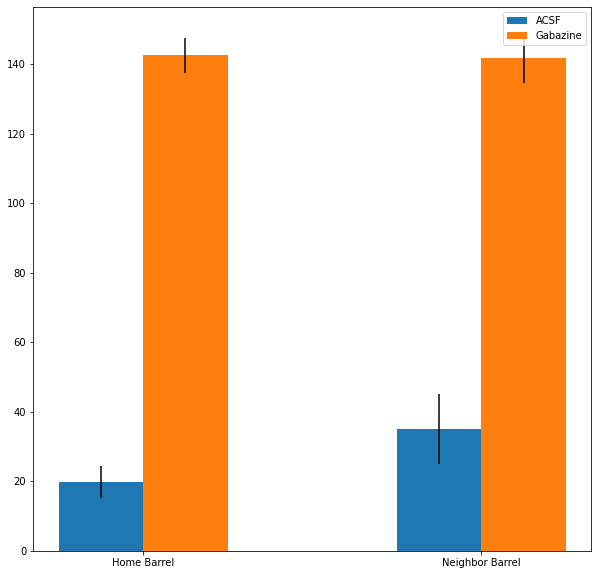

In [7]:
# compare control halfwidth ACSF versus GABAzine
# average over IPIs but compare Home versus Neighbor barrels and ACSF versus GABAzine

fig, ax = plt.subplots(1, 1, figsize=(10, 10))
handles = []
for drug in export_df['drug'].unique():
    drug_df = export_df[export_df['drug'] == drug]
    roi_df = drug_df[drug_df['ROI'] == 1]

    control_df = roi_df[roi_df['num_pulses'].str.contains('ontrol')]
    for roi in ['ROI1', 'ROI2']:
    

        halfwidths = []
        for _, control_row in control_df.iterrows():
        
            # get the trace and calculate halfwidth
            control_trace = read_dat_trace_file(control_row['trace'])[roi]

            # calculate maxAmp and its Pt index
            max_amp = control_trace.max()
            max_amp_idx = control_trace.idxmax()

            # calculate halfwidth (time from rising halfamp to falling halfamp)
            half_width = [0, 0]
            for i in range(max_amp_idx, len(control_trace)):
                if control_trace[i] < max_amp / 2:
                    # interpolate to get the exact time
                    half_width[0] = i + (control_trace[i] - max_amp / 2) / (control_trace[i] - control_trace[i - 1])
                    break

            for i in range(max_amp_idx, 0, -1):
                if control_trace[i] < max_amp / 2:
                    # interpolate to get the exact time
                    half_width[1] = i + (control_trace[i] - max_amp / 2) / (control_trace[i] - control_trace[i + 1])
                    break

            halfwidth = half_width[0] - half_width[1]
            halfwidths.append(halfwidth)
        print(halfwidths)
        i_plot_loc = int(roi[-1])
        i_plot_loc += (0.125 if drug == 'Gabazine' else -0.125)
        l1 = ax.bar(i_plot_loc, np.mean(halfwidths), yerr=sem(halfwidths),
                    label=drug, color= "tab:orange" if drug == 'Gabazine' else "tab:blue",
                    width=0.25)
        print(drug, roi, np.mean(halfwidths), sem(halfwidths))
        handles.append(l1)
# set ticks
ax.set_xticks([1, 2])
ax.set_xticklabels(['Home Barrel', 'Neighbor Barrel'])
ax.legend(handles=[handles[0], handles[-1]], labels=['ACSF', 'Gabazine'])
plt.show()
        


c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM\lib\site-packages\numpy\core\_methods.py:262: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM\lib\site-packages\numpy\core\_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM\lib\site-packages\numpy\core\_methods.py:254: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM\lib\site-packages\numpy\core\_methods.py:262: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM\lib\site-packages\numpy\core\_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.tr

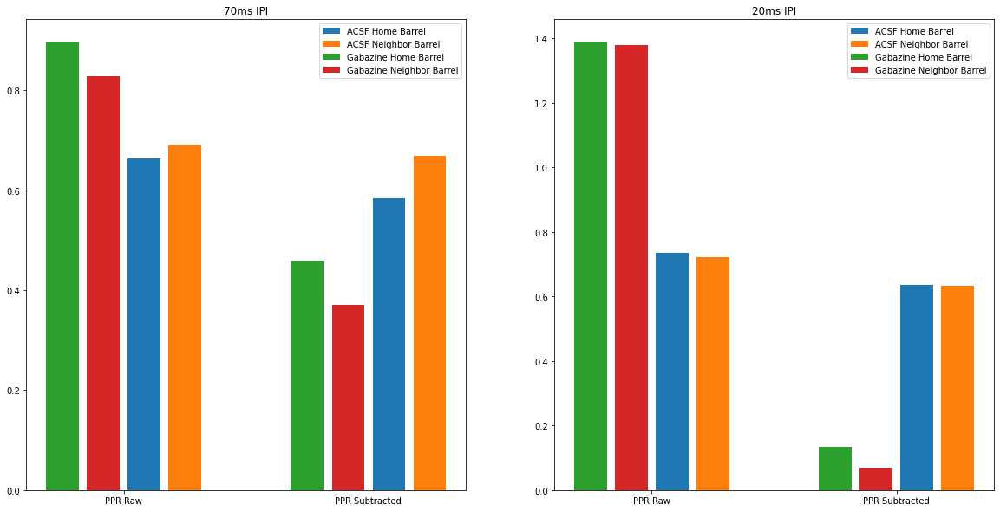

In [8]:
# plot ppr_raw and ppr_sub for each IPI on bar graphs
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
i_plot = -1
base_spacing_sub_vs_raw = 3
for ipi in ppr.keys():
    i_plot += 1
    for drug in ppr[ipi].keys():
        i_drug_shift = -1 if drug == 'Gabazine' else 1
        ppr_raw = []
        ppr_sub = []
        for roi in ppr[ipi][drug].keys():
            ax[i_plot].bar([ipi - base_spacing_sub_vs_raw + roi + i_drug_shift, ipi + base_spacing_sub_vs_raw + roi + i_drug_shift], 
                [ppr[ipi][drug][roi]['ppr_raw'], ppr[ipi][drug][roi]['ppr_sub']], 
                yerr=[sem(ppr_raw), sem(ppr_sub)], 
                label=drug + ' ' + ("Home" if roi == 1 else "Neighbor") + " Barrel")
    ax[i_plot].legend()
    ax[i_plot].set_title(str(ipi) + 'ms IPI')

    # label the x-ticks with PPR Raw and PPR Subtracted
    ax[i_plot].set_xticks([ipi - base_spacing_sub_vs_raw + 1.5, ipi + base_spacing_sub_vs_raw + 1.5])
    ax[i_plot].set_xticklabels(['PPR Raw', 'PPR Subtracted'])
plt.show()

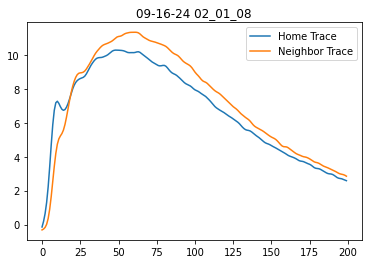

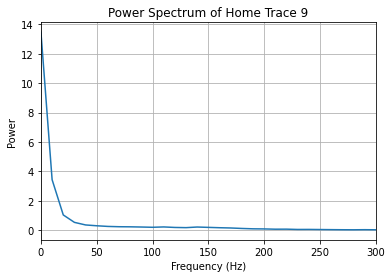

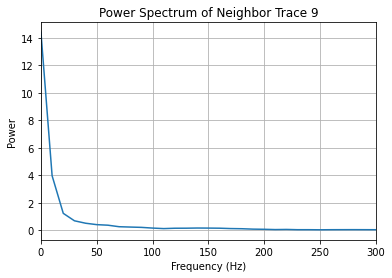

c:\Users\jjudge3\AppData\Local\anaconda3\envs\TSM\lib\site-packages\scipy\signal\spectral.py:1961: UserWarning: nperseg = 256 is greater than input length  = 200, using nperseg = 200
  warnings.warn('nperseg = {0:d} is greater than input length '


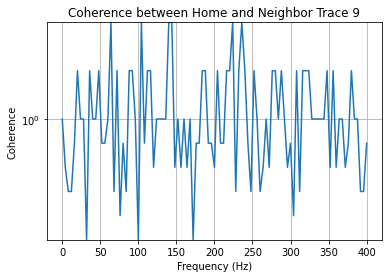

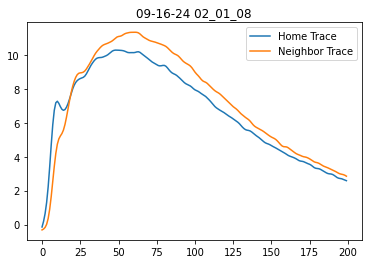

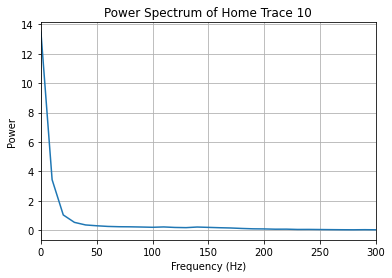

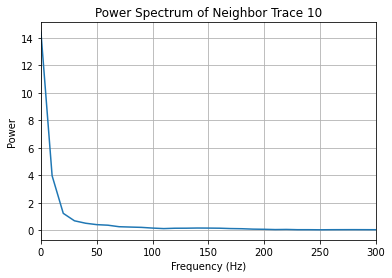

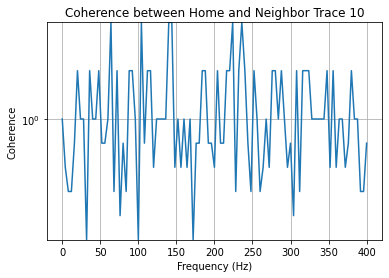

...

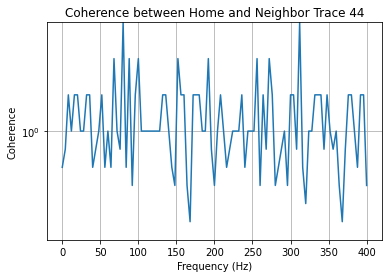

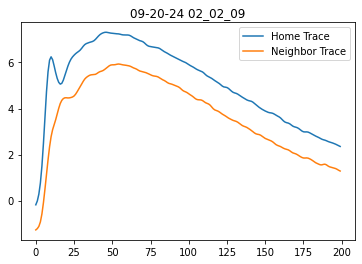

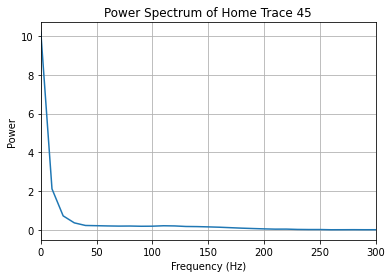

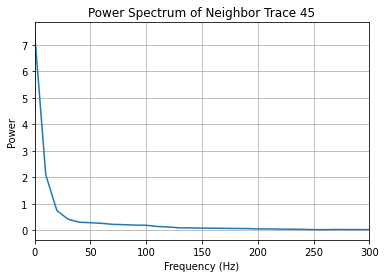

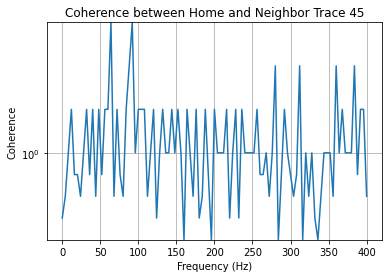

In [9]:
# read in the traces again. Now apply FFT and plot the power spectrum
# also calculate cross-correlation between the home and neighbor barrel traces (using scipy.signal.coherence)
# and plot the coherence

traces = export_df[export_df['ROI'] == 1]
home_traces = [read_dat_trace_file(trace)["ROI1"].values for trace in traces['trace']]
neighbor_traces = [read_dat_trace_file(trace)["ROI2"].values for trace in traces['trace']]
traces_drug_types = traces['drug']

# get date and zda_id for each trace
dates = [format_date(date) for date in traces['Date']]
zda_ids = [format_zda(slic, loc, rec) for slic, loc, rec in zip(traces['Slice'], traces['Location'], traces['Recording'])]

def plot_power_spectrum(trace, title, xlim=300):
    # Apply FFT
    N = len(trace)
    T = 0.5 / 1000  # in seconds -- Sample spacing
    yf = fft(trace)
    xf = np.fft.fftfreq(N, T)[:N//2]

    # Plot power spectrum
    plt.figure()
    plt.plot(xf, 2.0/N * np.abs(yf[:N//2]))
    plt.title(title)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Power')
    plt.xlim(0, xlim) 
    plt.grid()
    plt.show()

def plot_coherence(home_trace, neighbor_trace, title):
    # Calculate coherence
    f, Cxy = coherence(home_trace, neighbor_trace, fs=800)  # Adjust fs as needed

    # Plot coherence
    plt.figure()
    plt.semilogy(f, Cxy)
    plt.title(title)
    plt.xlabel('Frequency (Hz)')
    plt.ylabel('Coherence')
    plt.grid()
    plt.show()

# Loop over the traces in export_df
for idx, (home_trace, neighbor_trace) in enumerate(zip(home_traces, neighbor_traces)):

    if traces_drug_types.values[idx] == 'ACSF':
        continue

    # restrict traces to the measure window
    ipi = traces['ipi'].values[idx]
    window_start = 360 - ipi * 2
    home_trace = home_trace[window_start:window_start + 200]
    neighbor_trace = neighbor_trace[window_start:window_start + 200]

    # plot home and neighbor traces
    plt.figure()
    plt.plot(home_trace, label='Home Trace')
    plt.plot(neighbor_trace, label='Neighbor Trace')
    
    plt.title(dates[idx] + ' ' + zda_ids[idx])
    plt.legend()
    plt.show()

    # Plot power spectrum for home trace
    plot_power_spectrum(home_trace, f'Power Spectrum of Home Trace {idx+1}')
    
    # Plot power spectrum for neighbor trace
    plot_power_spectrum(neighbor_trace, f'Power Spectrum of Neighbor Trace {idx+1}')
    
    # Plot coherence between home and neighbor traces
    plot_coherence(home_trace, neighbor_trace, f'Coherence between Home and Neighbor Trace {idx+1}')

In [10]:
# Loop over the traces in export_df
traces = [read_dat_trace_file(trace) for trace in single_df['trace']]
single_df

,ROI_File,ROI_Set,Date,Slice,Location,Recording,trace,ipi,drug,num_pulses
0,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial1,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial2,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
2,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial3,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
3,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial4,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
4,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_1roisroi_rand_0 trial5,9/16/2024,2,1,1,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,70,ACSF,PPR
...,...,...,...,...,...,...,...,...,...,...
285,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_2roisroi_rand_1 trial1,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,120,Gabazine,Control
286,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_2roisroi_rand_1 trial2,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,120,Gabazine,Control
287,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_2roisroi_rand_1 trial3,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,120,Gabazine,Control
288,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,2_2roisroi_rand_1 trial4,9/20/2024,2,2,9,C:/Users/jjudge3/Desktop/Data/mm_full_pipeline...,120,Gabazine,Control


[20, 116]
[120, 356]


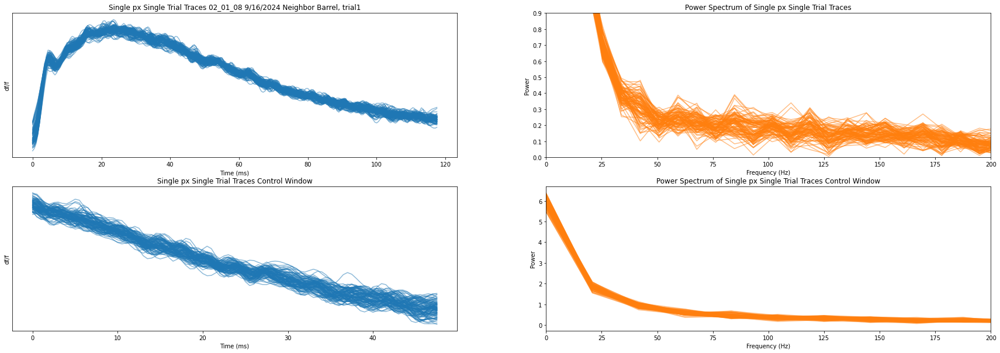

[20, 116]
[120, 356]


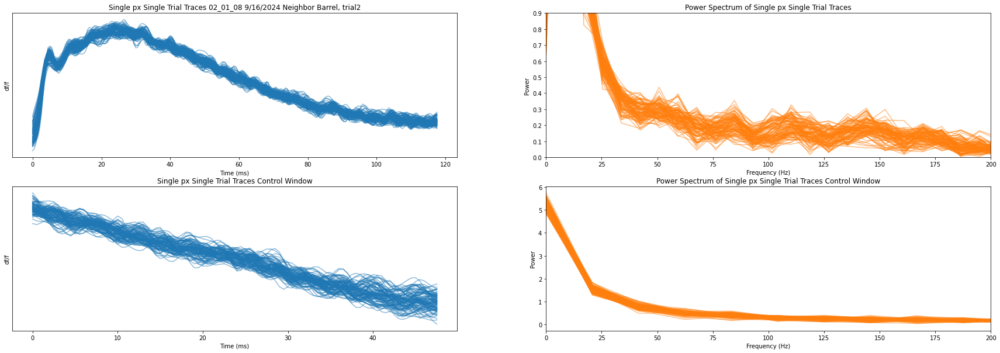

[20, 116]
[120, 356]


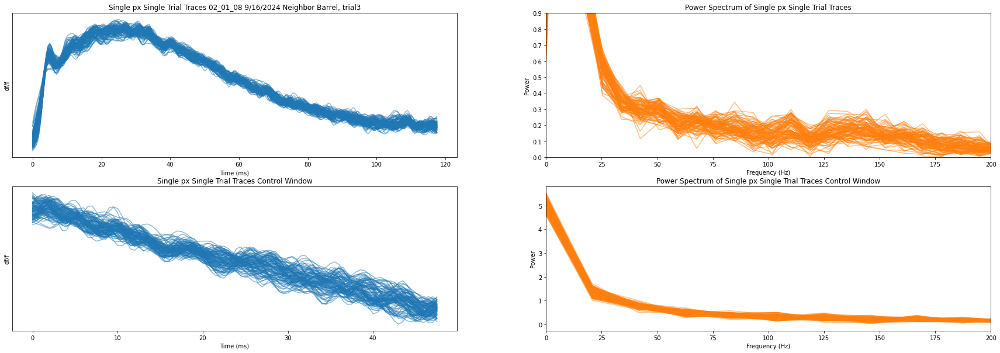

[20, 116]
[120, 356]


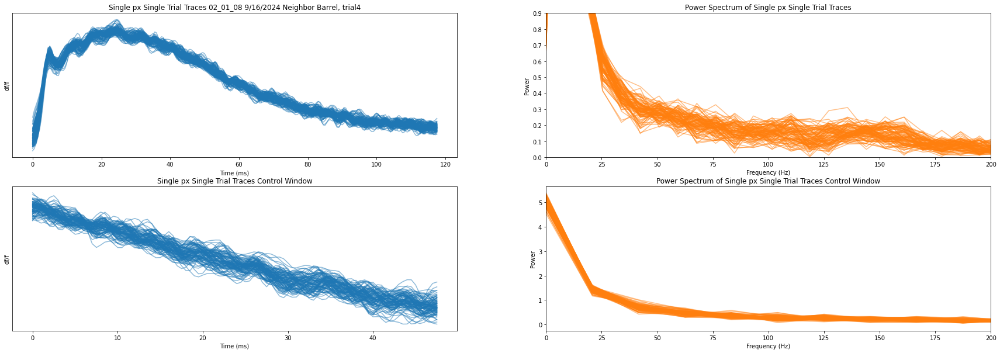

[20, 116]
[120, 356]


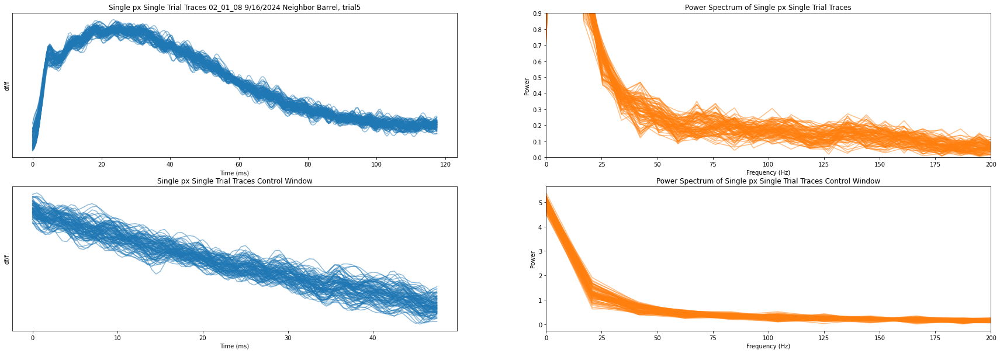

[20, 116]
[120, 356]


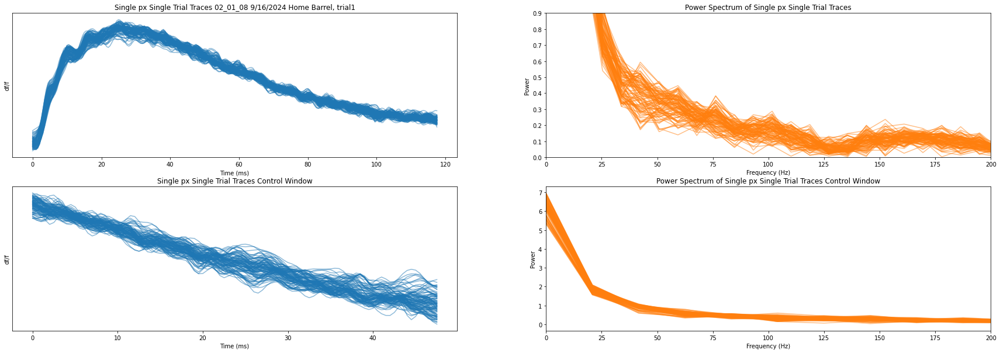

[20, 116]
[120, 356]


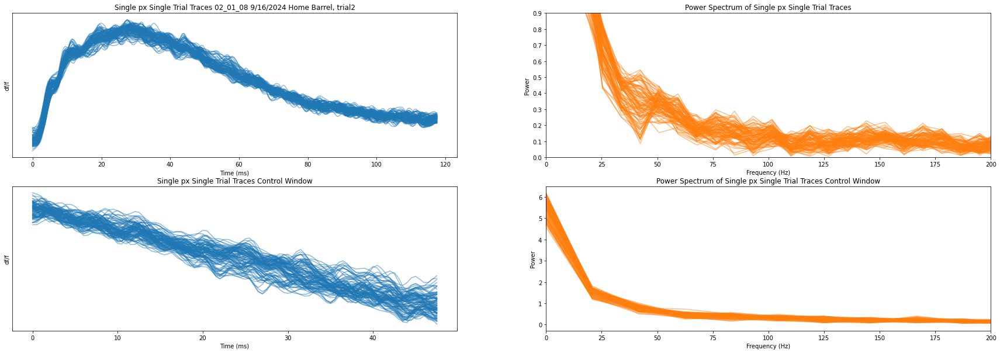

[20, 116]
[120, 356]


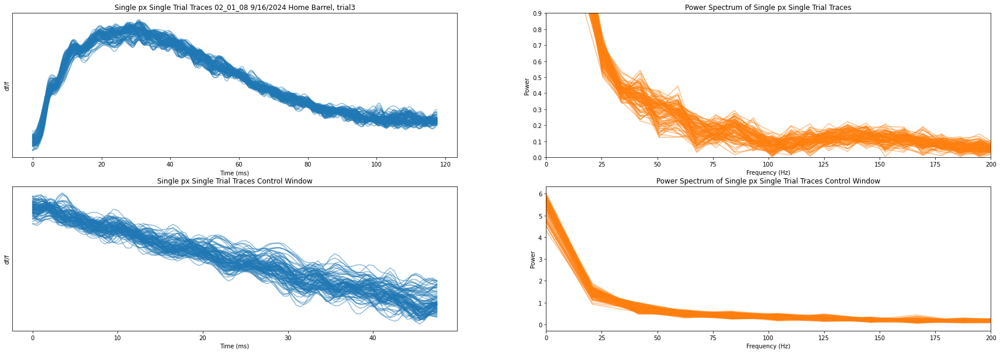

[20, 116]
[120, 356]


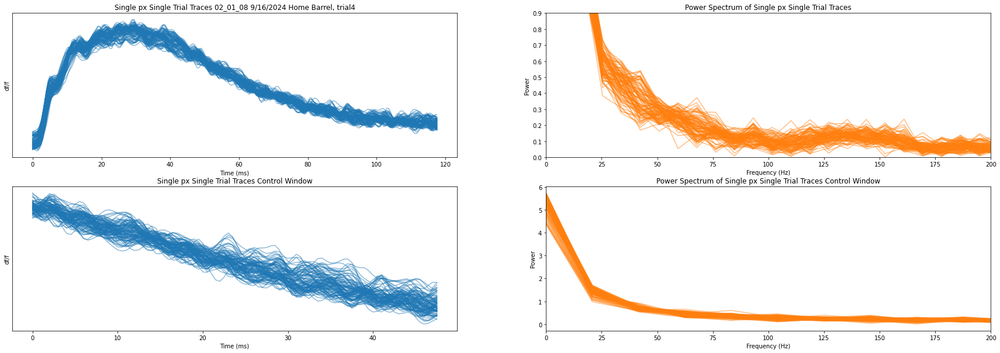

[20, 116]
[120, 356]


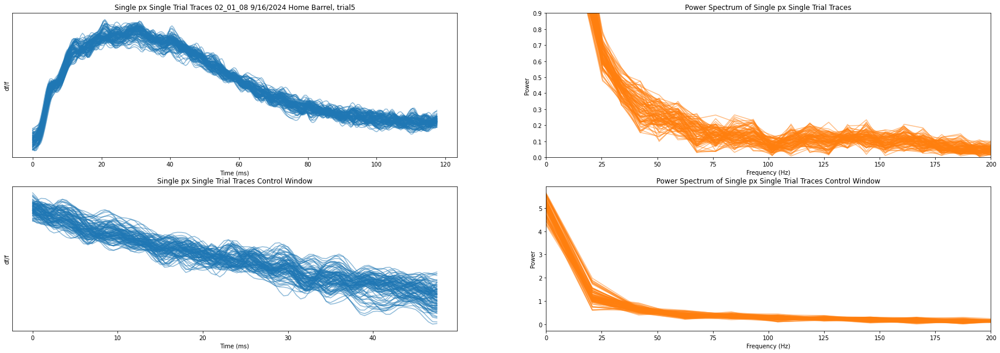

[20, 116]
[120, 356]


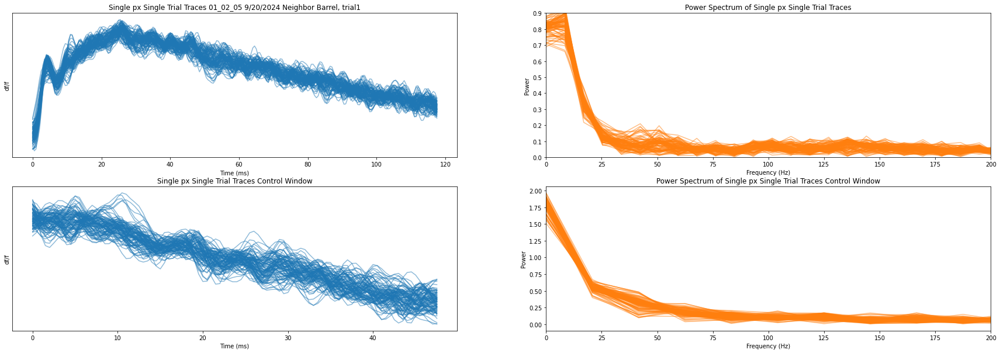

[20, 116]
[120, 356]


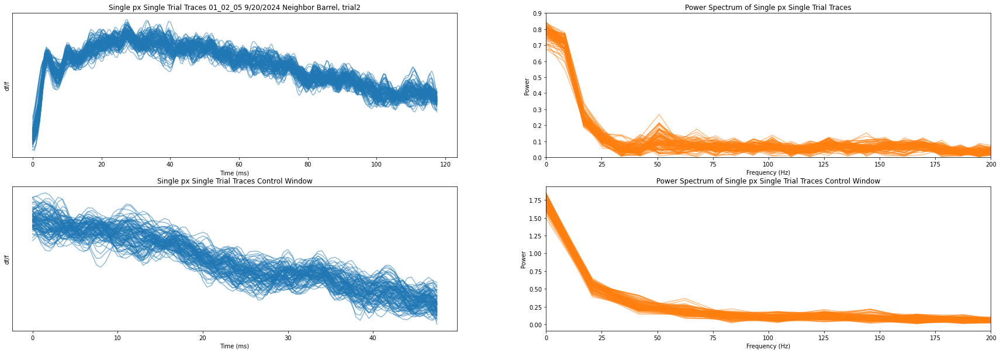

[20, 116]
[120, 356]


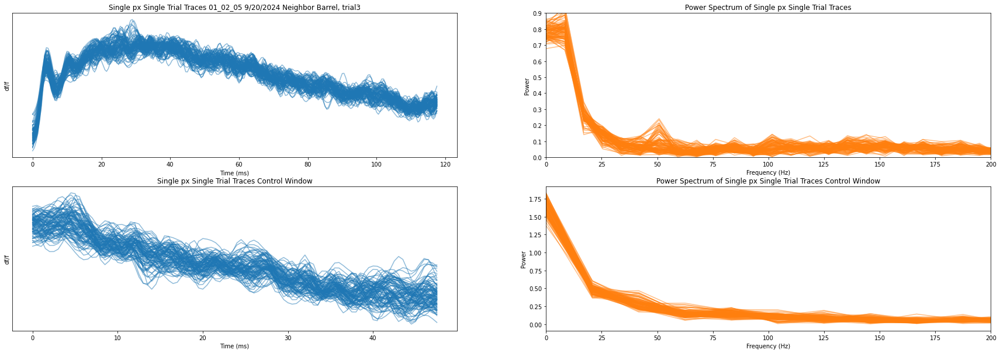

[20, 116]
[120, 356]


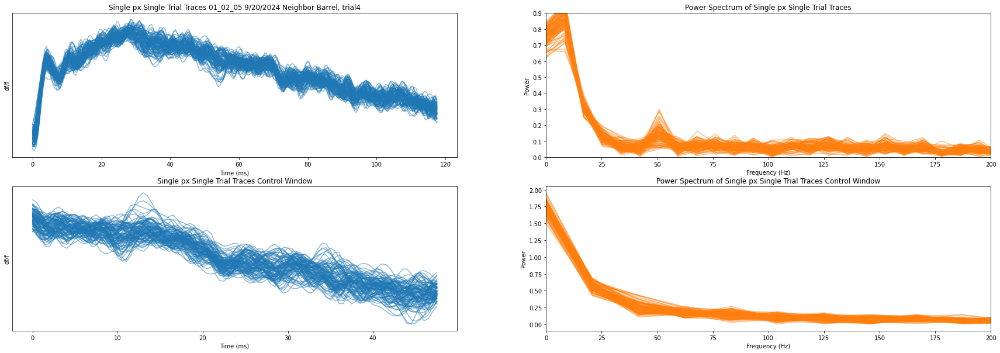

[20, 116]
[120, 356]


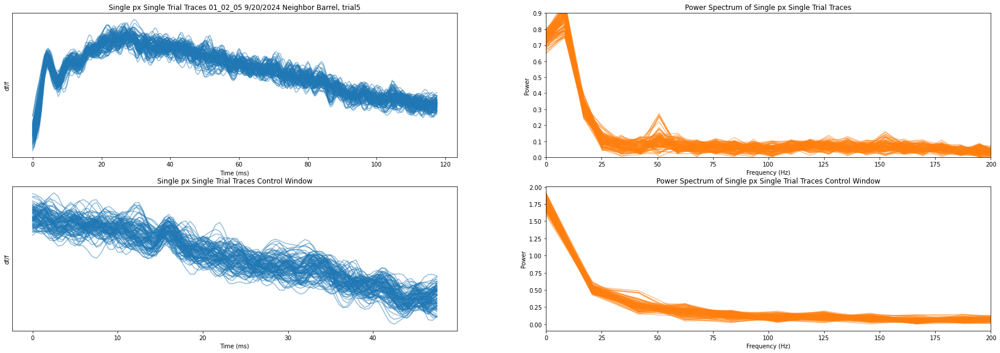

[20, 116]
[120, 356]


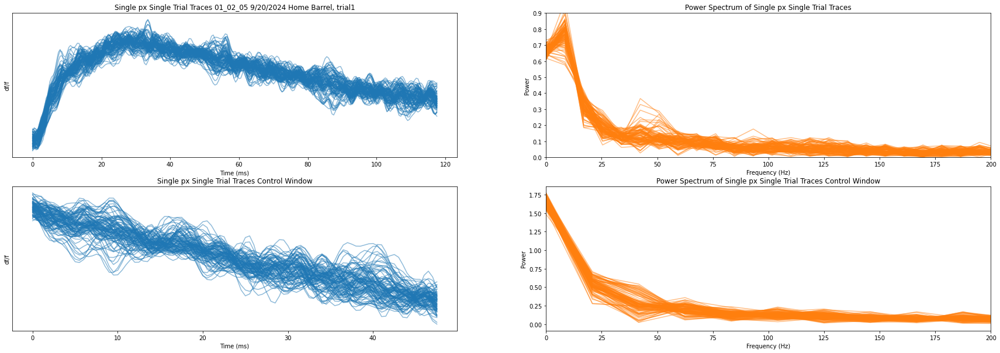

[20, 116]
[120, 356]


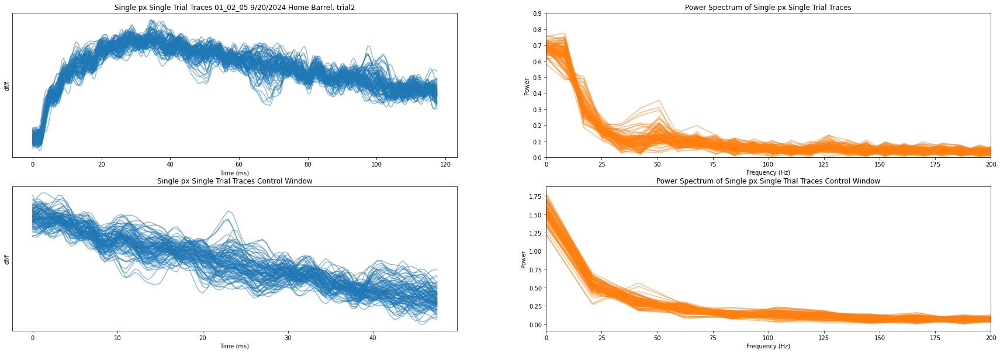

[20, 116]
[120, 356]


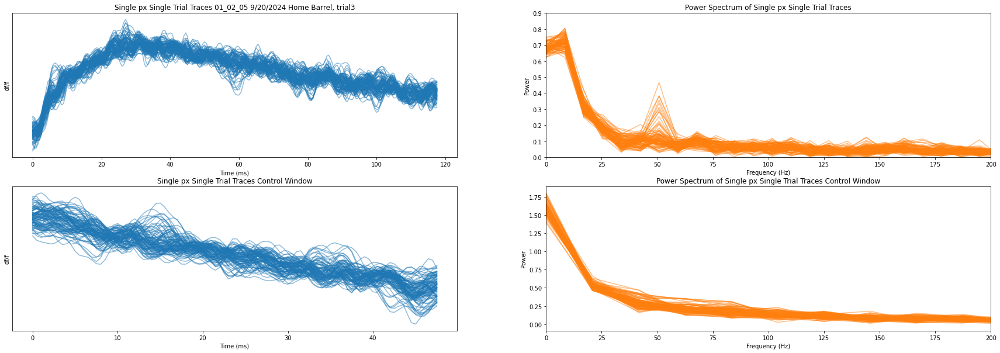

[20, 116]
[120, 356]


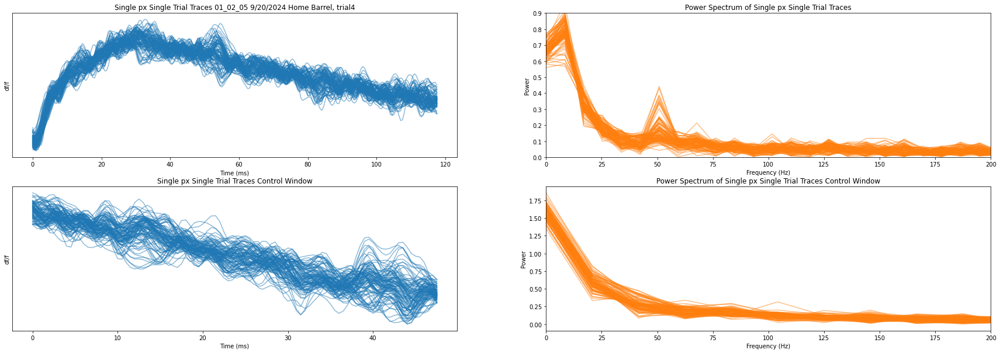

[20, 116]
[120, 356]


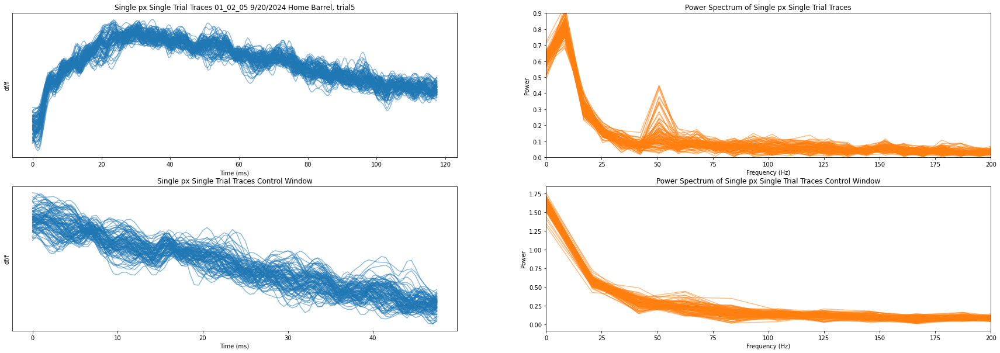

[20, 116]
[120, 356]


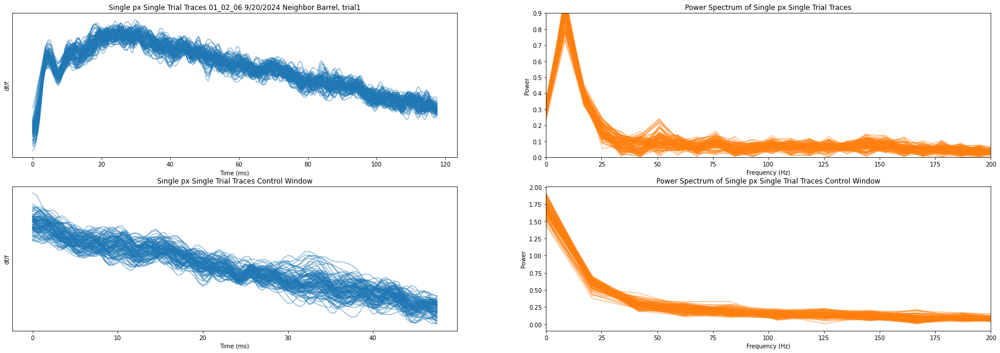

[20, 116]
[120, 356]


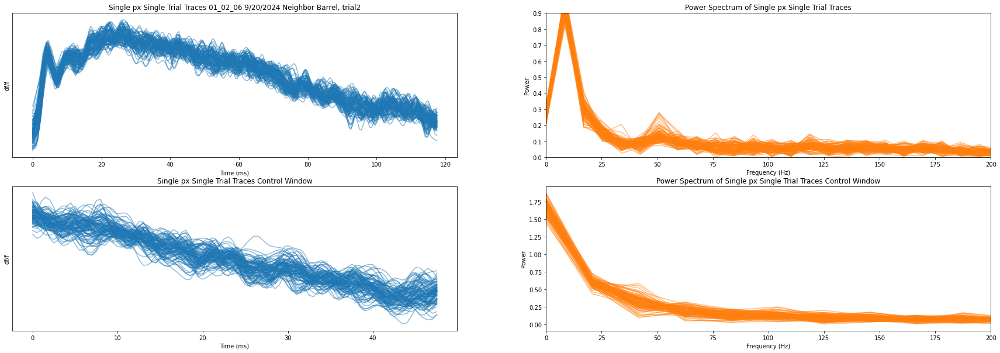

[20, 116]
[120, 356]


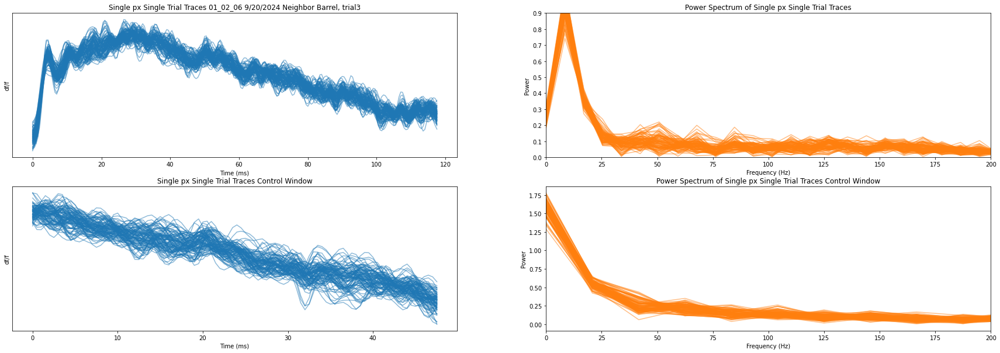

[20, 116]
[120, 356]


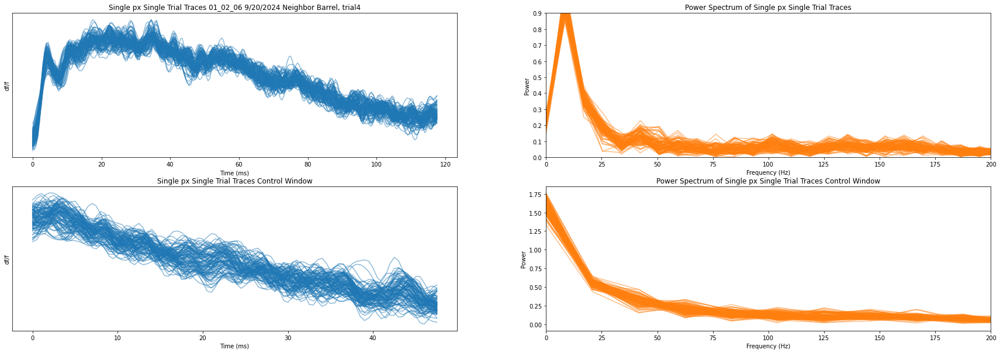

[20, 116]
[120, 356]


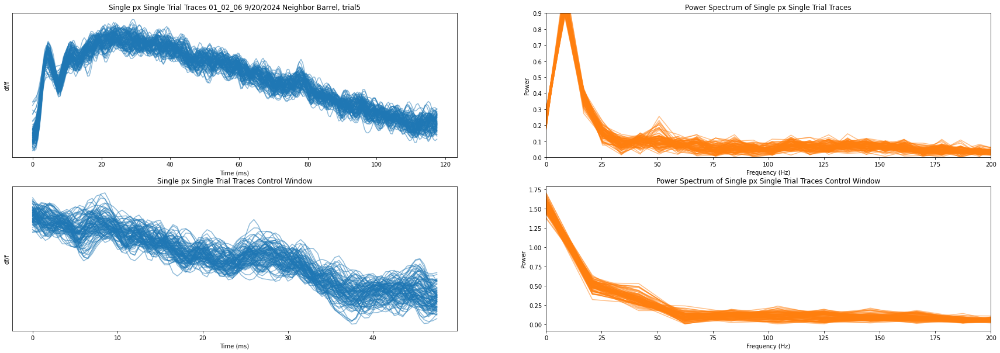

[20, 116]
[120, 356]


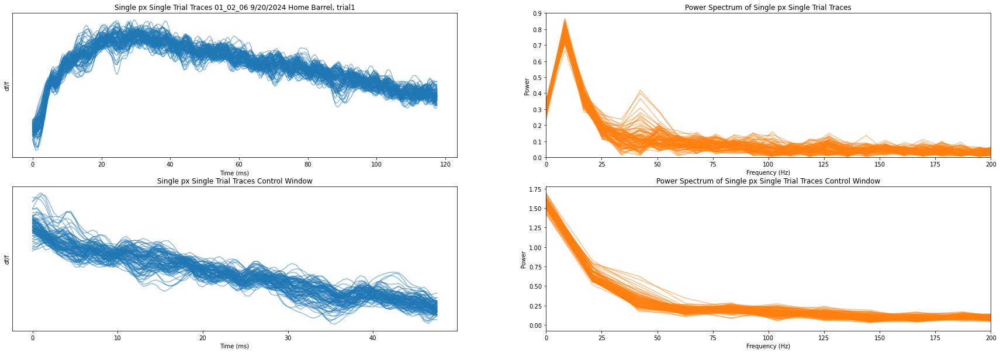

[20, 116]
[120, 356]


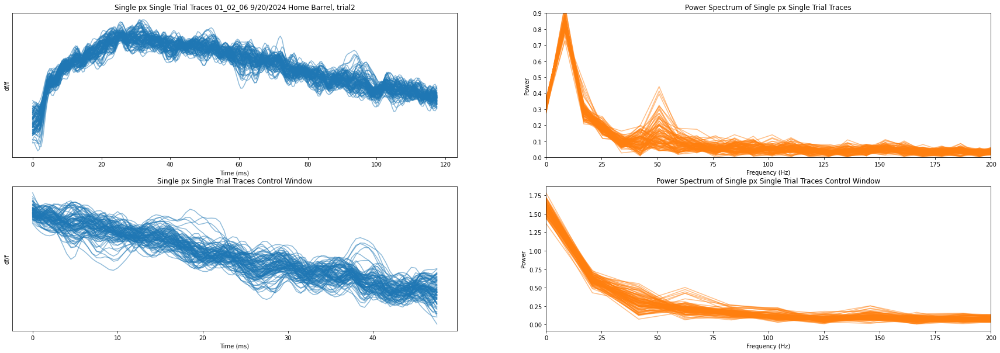

[20, 116]
[120, 356]


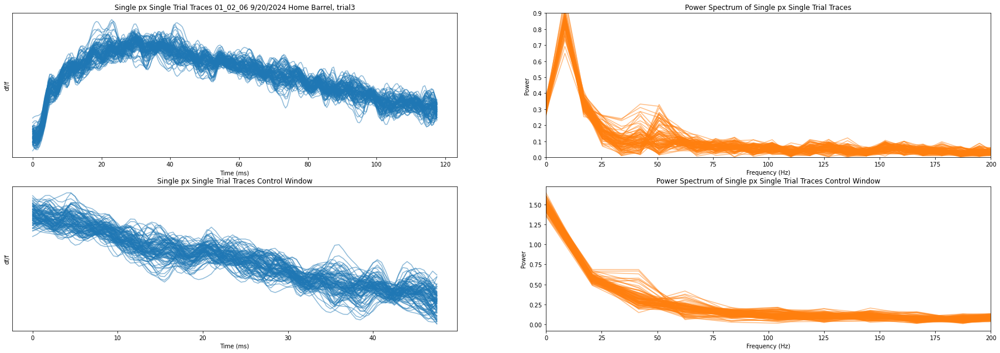

[20, 116]
[120, 356]


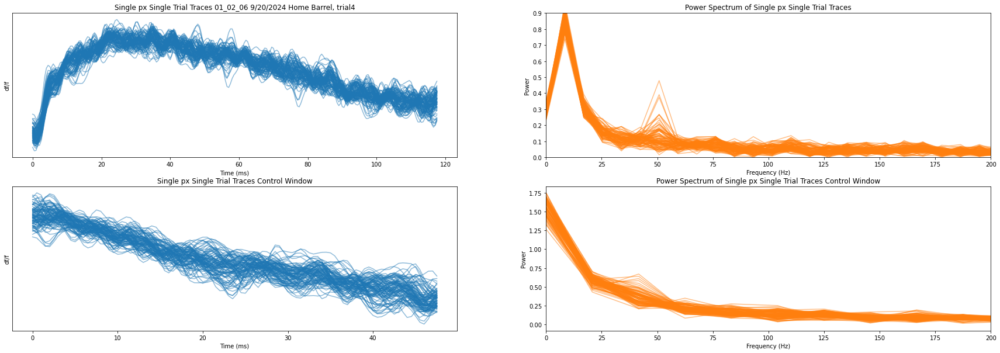

[20, 116]
[120, 356]


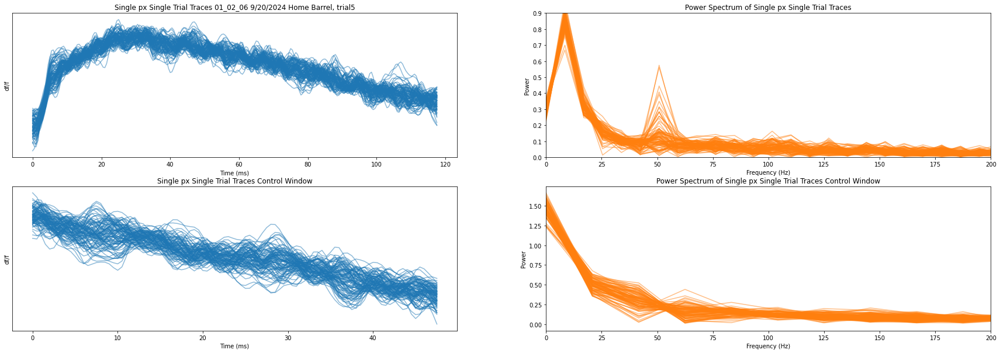

[20, 116]
[120, 356]


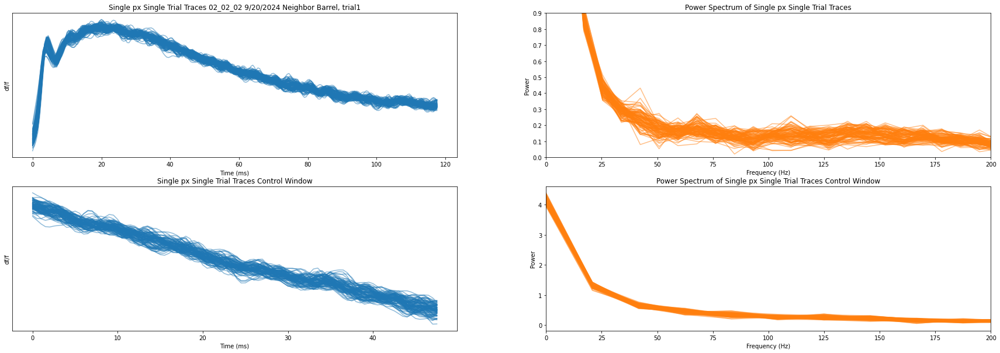

[20, 116]
[120, 356]


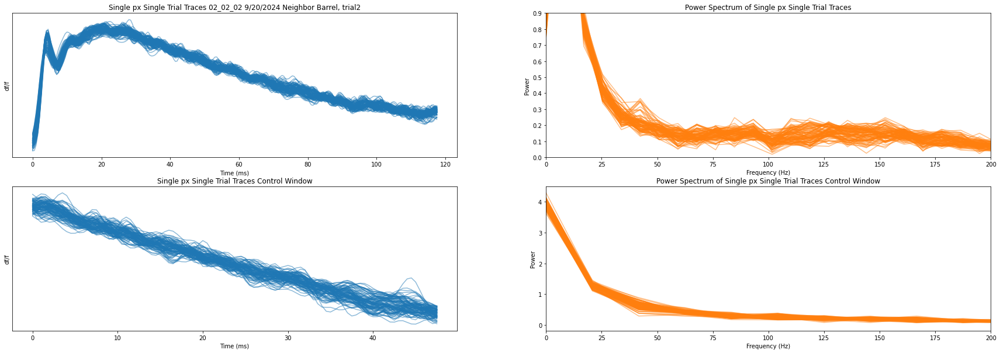

[20, 116]
[120, 356]


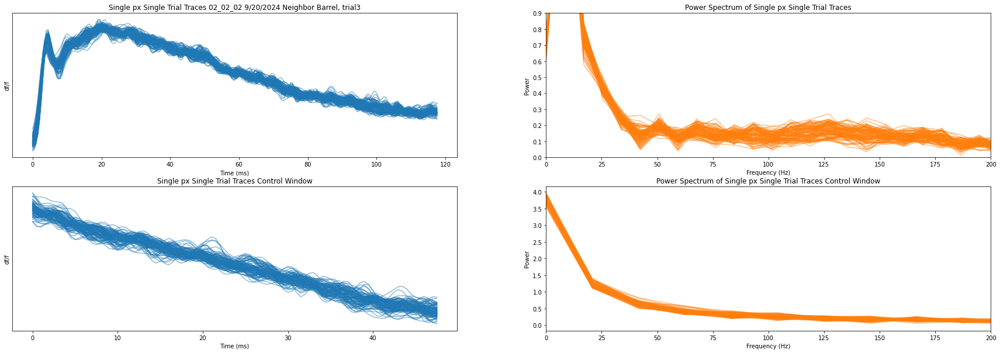

[20, 116]
[120, 356]


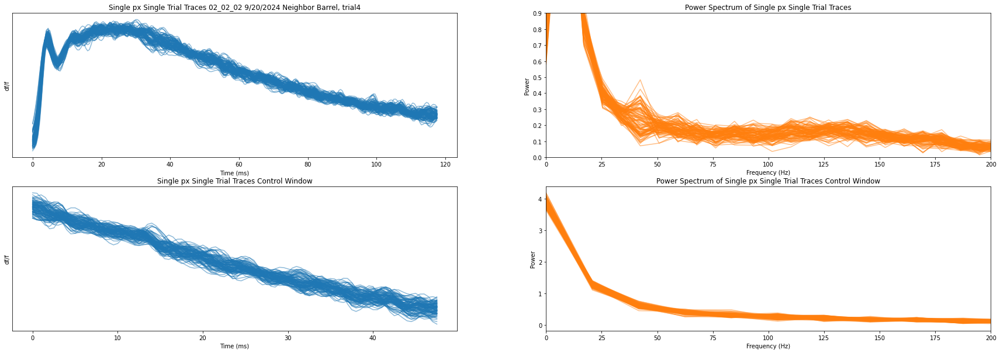

[20, 116]
[120, 356]


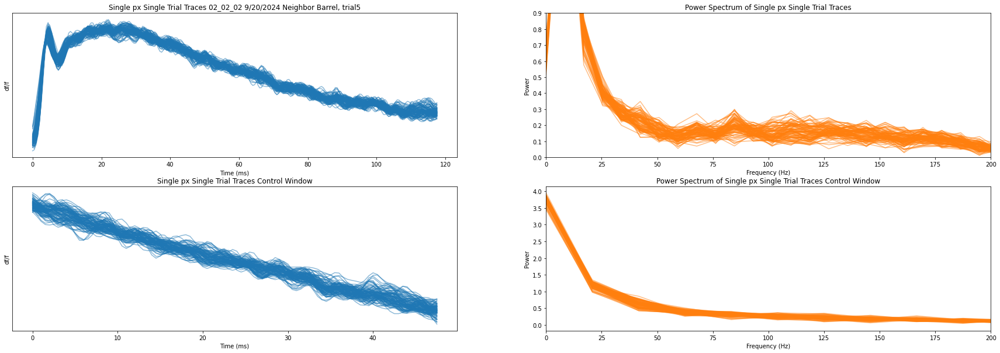

[20, 116]
[120, 356]


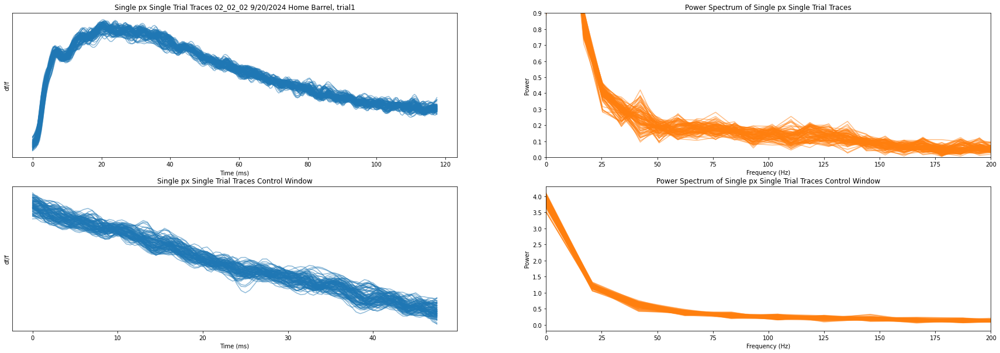

[20, 116]
[120, 356]


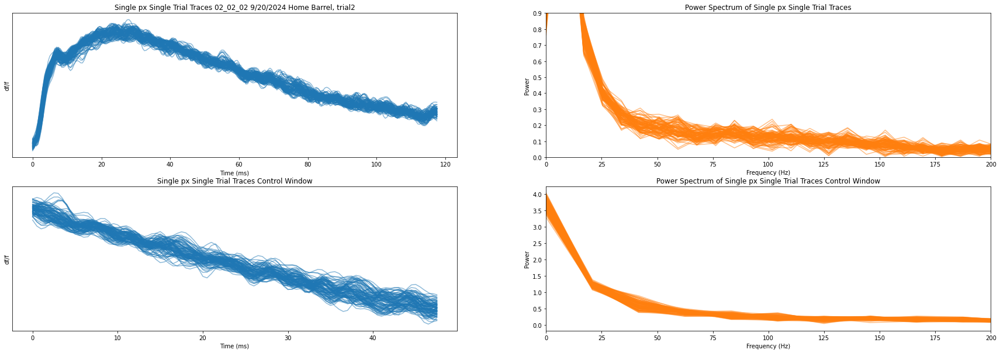

[20, 116]
[120, 356]


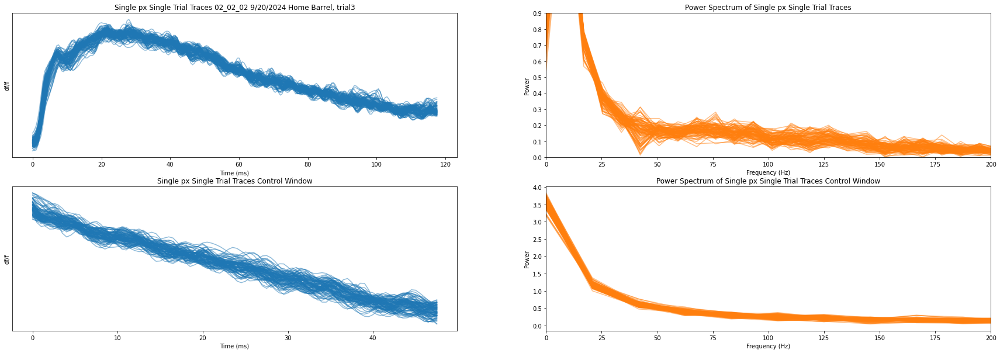

[20, 116]
[120, 356]


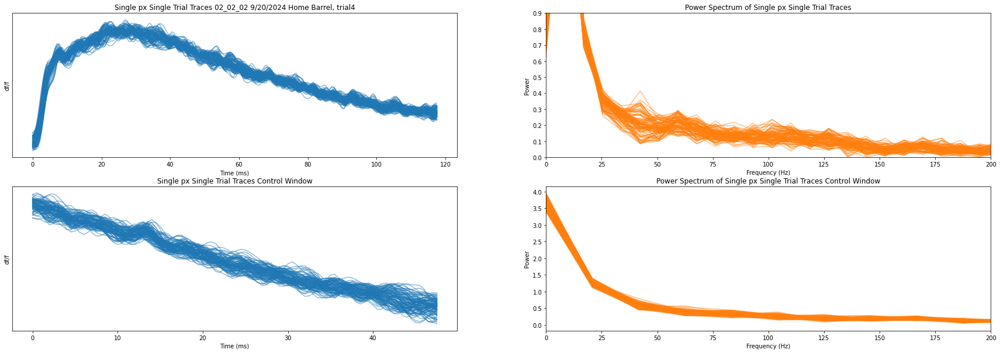

[20, 116]
[120, 356]


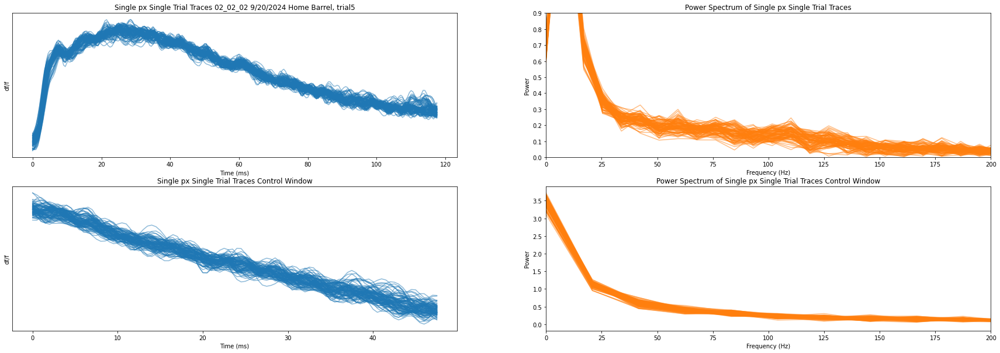

[20, 116]
[120, 356]


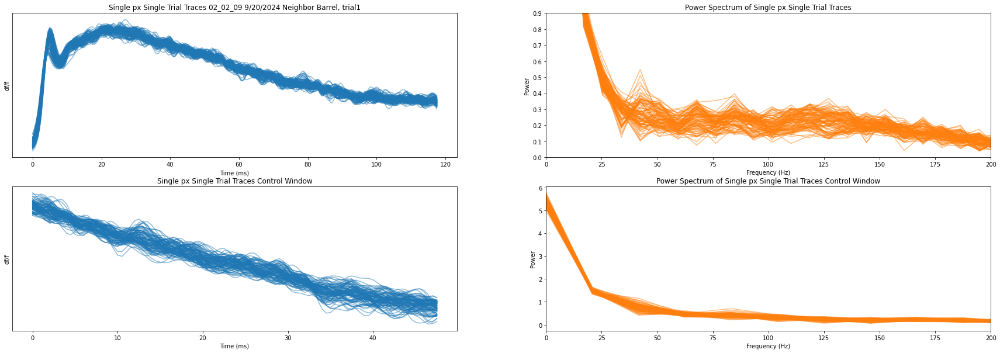

[20, 116]
[120, 356]


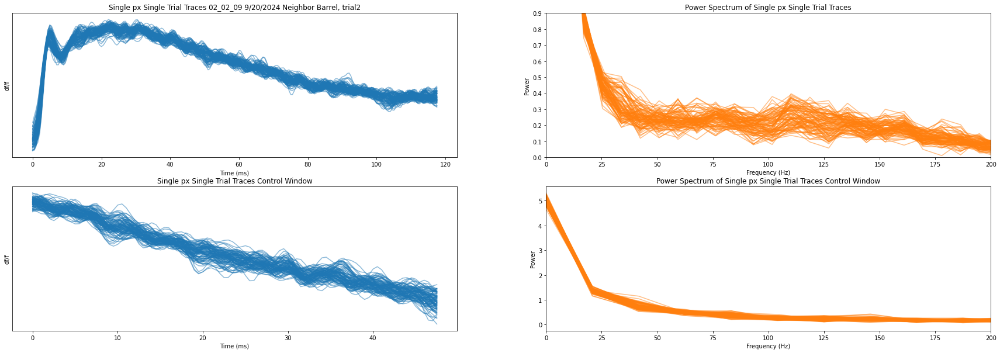

[20, 116]
[120, 356]


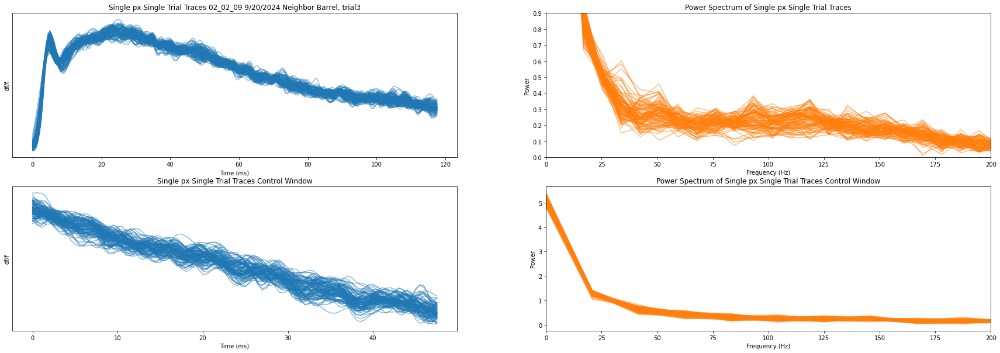

[20, 116]
[120, 356]


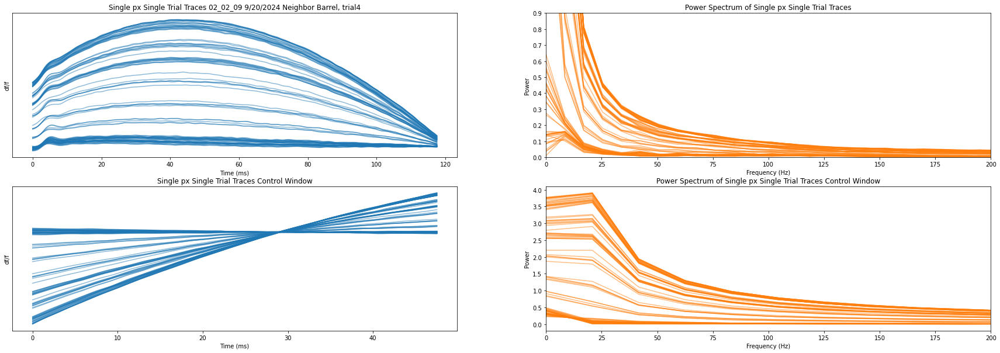

[20, 116]
[120, 356]


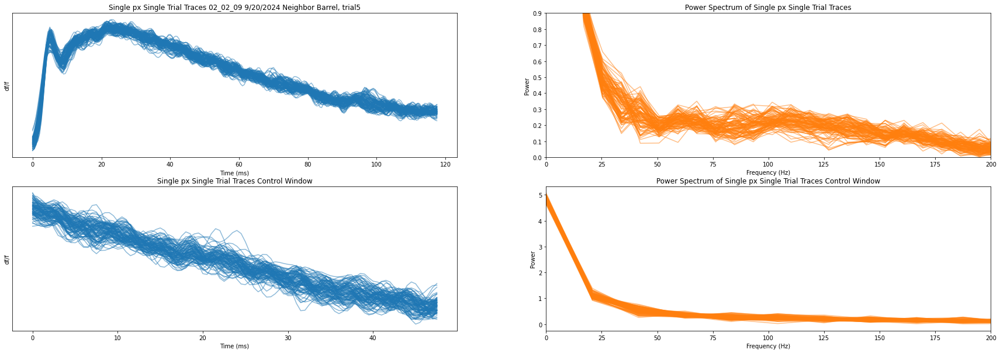

[20, 116]
[120, 356]


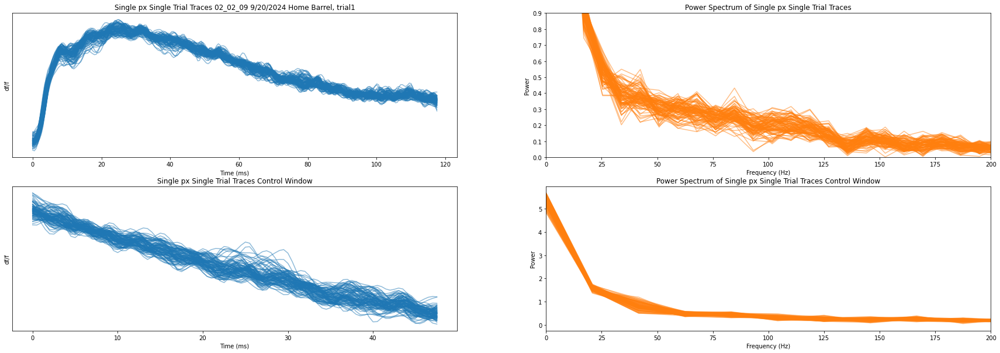

[20, 116]
[120, 356]


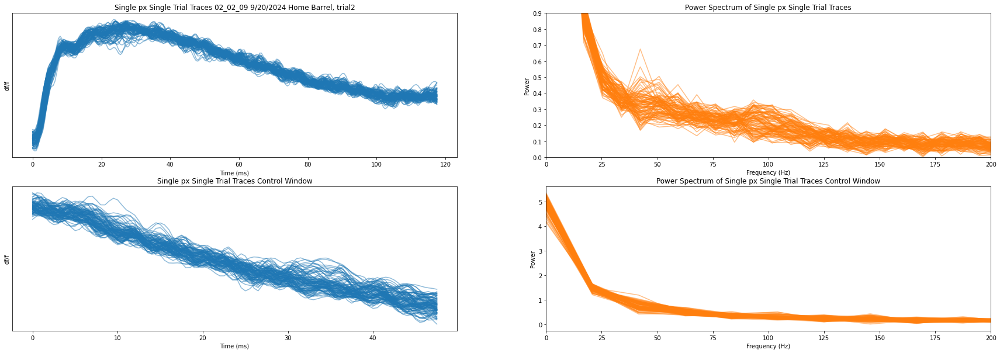

[20, 116]
[120, 356]


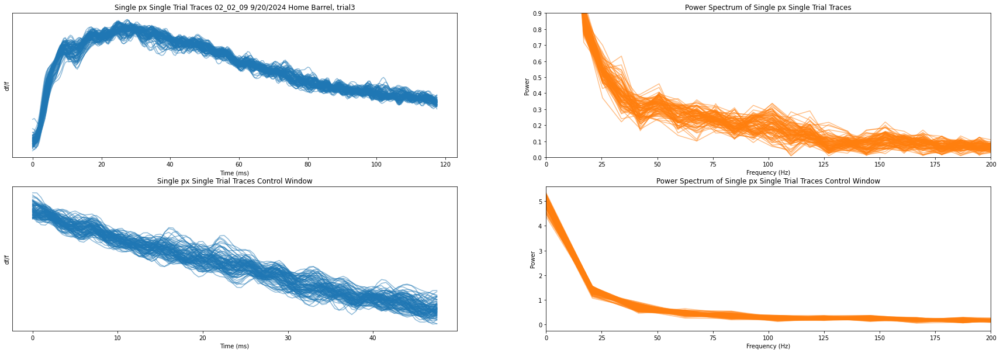

[20, 116]
[120, 356]


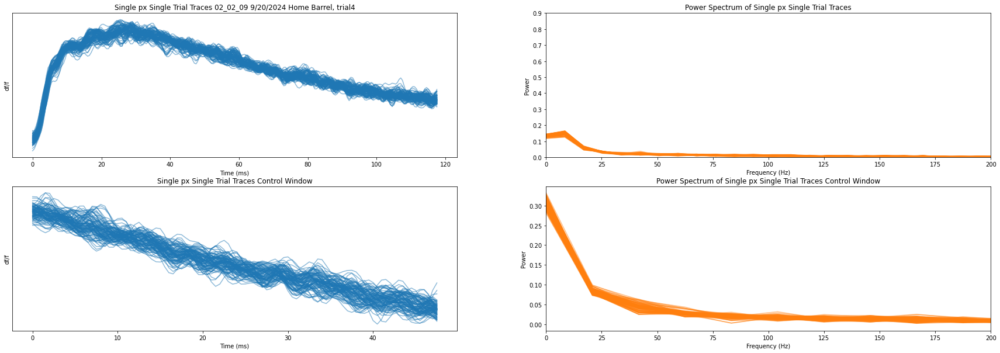

[20, 116]
[120, 356]


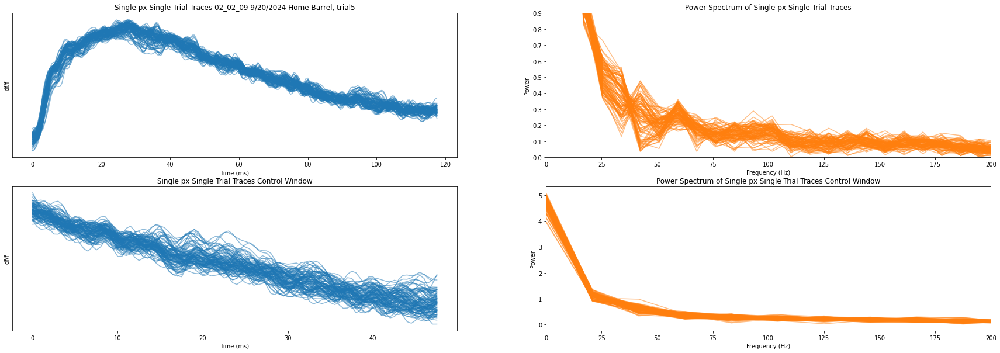

In [11]:
alph = 0.5
zda_ids = [format_zda(slic, loc, rec) for slic, loc, rec in zip(single_df['Slice'], single_df['Location'], single_df['Recording'])]
barrel_traces_single_px = {}
for idx, trace_orig in enumerate(traces):

    if single_df['drug'].values[idx] == 'ACSF':
        continue

    # restrict traces to the measure window
    ipi = single_df['ipi'].values[idx]
    if ipi < 120:
        continue
    window_start = 360 - ipi * 2
    trace = trace_orig[window_start:356]

    # control window
    control_window = [20, window_start - 4]
    control_trace = trace_orig[control_window[0]:control_window[1]]
    print(control_window)
    print([window_start, 356])
    
    # collect the traces for cross-correlation
    date = single_df['Date'].values[idx]
    zda_id = zda_ids[idx]
    which_barrel = single_df['ROI_Set'].values[idx].split('rand_')[-1][0]
    which_barrel = 'Home' if which_barrel == '1' else 'Neighbor'
    i_trial = int(single_df['ROI_Set'].values[idx].split('trial')[-1])

    # pull X-center and Y-center of each roi from the single_df
    roi_file = single_df['ROI_File'].values[idx]
    rois_ = ROIFileReader(roi_file).get_roi_list()
    rois_ = [LaminarROI(r, input_diode_numbers=True)
            for r in rois_]
    rois_centers = [roi.get_center() for roi in rois_]


    if date not in barrel_traces_single_px:
        barrel_traces_single_px[date] = {}
    if zda_id not in barrel_traces_single_px[date]:
        barrel_traces_single_px[date][zda_id] = {}
    if which_barrel not in barrel_traces_single_px[date][zda_id]:
        barrel_traces_single_px[date][zda_id][which_barrel] = {}
    if i_trial not in barrel_traces_single_px[date][zda_id][which_barrel]:
        barrel_traces_single_px[date][zda_id][which_barrel][i_trial] = {'trace_orig': trace_orig, 
                                                                        'trace_mw': [window_start, 356], 
                                                                        'control_trace_mw': control_window,
                                                                        'roi_centers': rois_centers
                                                                        }

    fig, ax = plt.subplots(2, 2, figsize=(30, 10))
    for roi_idx in trace.columns:
        if roi_idx == 'Pt':
            continue
        
        # x-axis is time in increments of 0.5 ms
        t = np.arange(0, len(trace[roi_idx].values) / 2, 0.5)

        ax1 = ax[0]
        

        ax1[0].plot(t, trace[roi_idx].values, alpha=alph, color='tab:blue')
        ax1[0].set_title('Single px Single Trial Traces' + ' ' + zda_id + ' ' 
                + date + " " + which_barrel + " Barrel, trial" + single_df['ROI_Set'].values[idx].split('trial')[-1])
        ax1[0].set_xlabel('Time (ms)')
        ax1[0].set_ylabel('df/f')
        ax1[0].set_yticks([])

        # plot power spectrum for all traces
        # Apply FFT
        N = len(trace)
        T = 0.5 / 1000  # in seconds -- Sample spacing
        yf = fft(trace[roi_idx].values)
        xf = np.fft.fftfreq(N, T)[:N//2]

        # Plot power spectrum
        ax1[1].plot(xf, 2.0/N * np.abs(yf[:N//2]), alpha=alph, color='tab:orange')
        ax1[1].set_xlim(0, 200)
        ax1[1].set_ylim(0, 0.9)
        ax1[1].set_title('Power Spectrum of Single px Single Trial Traces')
        ax1[1].set_xlabel('Frequency (Hz)')
        ax1[1].set_ylabel('Power')

        ax2 = ax[1]
        t = np.arange(0, len(control_trace[roi_idx].values) / 2, 0.5)

        # plot the same for the control window
        N = len(control_trace)
        T = 0.5 / 1000
        yf = fft(control_trace[roi_idx].values)
        xf = np.fft.fftfreq(N, T)[:N//2]

        # Plot power spectrum
        ax2[1].plot(xf, 2.0/N * np.abs(yf[:N//2]), alpha=alph, color='tab:orange')
        ax2[1].set_xlim(0, 200)
        ax2[1].set_title('Power Spectrum of Single px Single Trial Traces Control Window')
        ax2[1].set_xlabel('Frequency (Hz)')
        ax2[1].set_ylabel('Power')

        # plot the control trace
        ax2[0].plot(t, control_trace[roi_idx].values, alpha=alph, color='tab:blue')
        ax2[0].set_title('Single px Single Trial Traces Control Window')
        ax2[0].set_xlabel('Time (ms)')
        ax2[0].set_ylabel('df/f')
        ax2[0].set_yticks([])
    plt.show()
   


Working on trial 1
Working on home ROI ROI1 for trial 1
Working on home ROI ROI2 for trial 1
Working on home ROI ROI3 for trial 1
Working on home ROI ROI4 for trial 1
Working on home ROI ROI5 for trial 1
Working on home ROI ROI6 for trial 1
Working on home ROI ROI7 for trial 1
Working on home ROI ROI8 for trial 1
Working on home ROI ROI9 for trial 1
Working on home ROI ROI10 for trial 1
Working on home ROI ROI11 for trial 1
Working on home ROI ROI12 for trial 1
Working on home ROI ROI13 for trial 1
Working on home ROI ROI14 for trial 1
Working on home ROI ROI15 for trial 1
Working on home ROI ROI16 for trial 1
Working on home ROI ROI17 for trial 1
Working on home ROI ROI18 for trial 1
Working on home ROI ROI19 for trial 1
Working on home ROI ROI20 for trial 1
Working on home ROI ROI21 for trial 1
Working on home ROI ROI22 for trial 1
Working on home ROI ROI23 for trial 1
Working on home ROI ROI24 for trial 1
Working on home ROI ROI25 for trial 1
Working on home ROI ROI26 for trial 1
Wo

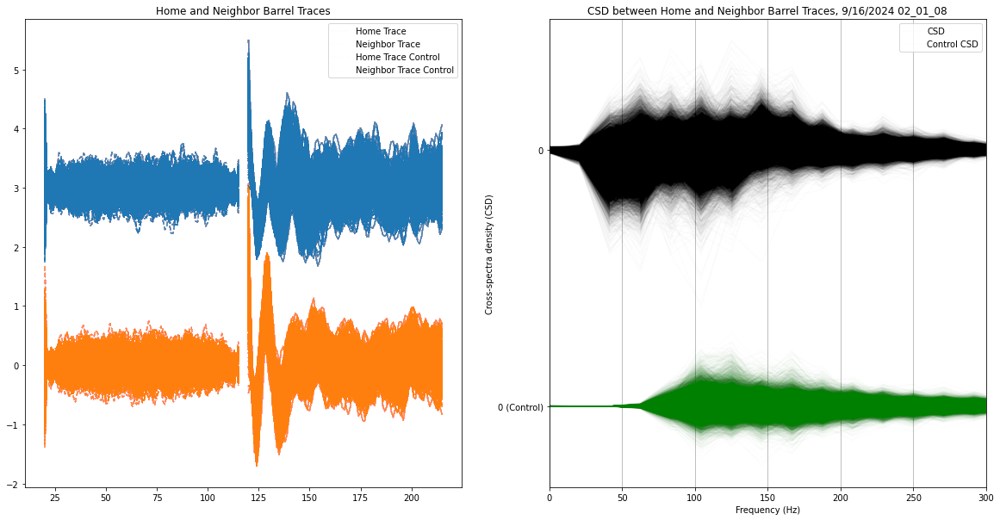

Working on trial 1
Working on home ROI ROI1 for trial 1
Working on home ROI ROI2 for trial 1
Working on home ROI ROI3 for trial 1
Working on home ROI ROI4 for trial 1
Working on home ROI ROI5 for trial 1
Working on home ROI ROI6 for trial 1
Working on home ROI ROI7 for trial 1
Working on home ROI ROI8 for trial 1
Working on home ROI ROI9 for trial 1
Working on home ROI ROI10 for trial 1
Working on home ROI ROI11 for trial 1
Working on home ROI ROI12 for trial 1
Working on home ROI ROI13 for trial 1
Working on home ROI ROI14 for trial 1
Working on home ROI ROI15 for trial 1
Working on home ROI ROI16 for trial 1
Working on home ROI ROI17 for trial 1
Working on home ROI ROI18 for trial 1
Working on home ROI ROI19 for trial 1
Working on home ROI ROI20 for trial 1
Working on home ROI ROI21 for trial 1
Working on home ROI ROI22 for trial 1
Working on home ROI ROI23 for trial 1
Working on home ROI ROI24 for trial 1
Working on home ROI ROI25 for trial 1
Working on home ROI ROI26 for trial 1
Wo

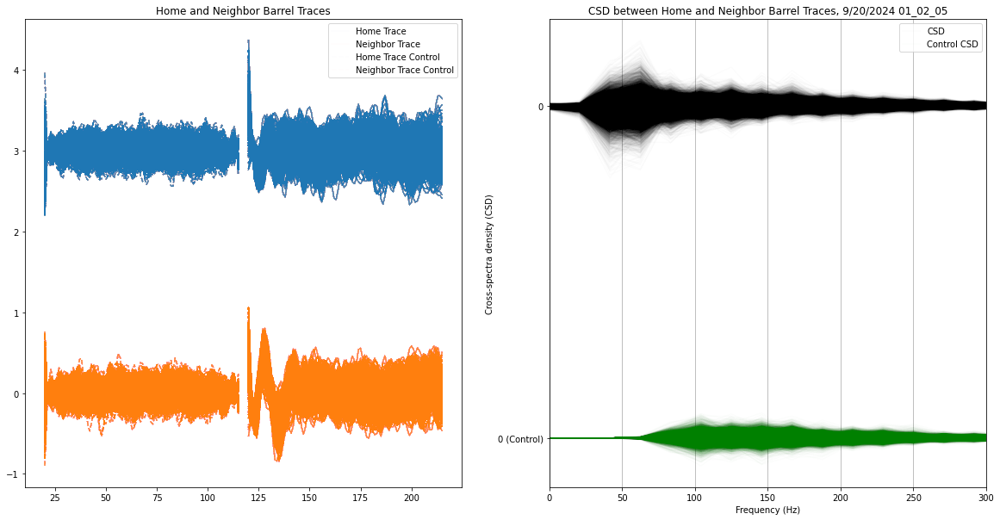

Working on trial 1
Working on home ROI ROI1 for trial 1
Working on home ROI ROI2 for trial 1
Working on home ROI ROI3 for trial 1
Working on home ROI ROI4 for trial 1
Working on home ROI ROI5 for trial 1
Working on home ROI ROI6 for trial 1
Working on home ROI ROI7 for trial 1
Working on home ROI ROI8 for trial 1
Working on home ROI ROI9 for trial 1
Working on home ROI ROI10 for trial 1
Working on home ROI ROI11 for trial 1
Working on home ROI ROI12 for trial 1
Working on home ROI ROI13 for trial 1
Working on home ROI ROI14 for trial 1
Working on home ROI ROI15 for trial 1
Working on home ROI ROI16 for trial 1
Working on home ROI ROI17 for trial 1
Working on home ROI ROI18 for trial 1
Working on home ROI ROI19 for trial 1
Working on home ROI ROI20 for trial 1
Working on home ROI ROI21 for trial 1
Working on home ROI ROI22 for trial 1
Working on home ROI ROI23 for trial 1
Working on home ROI ROI24 for trial 1
Working on home ROI ROI25 for trial 1
Working on home ROI ROI26 for trial 1
Wo

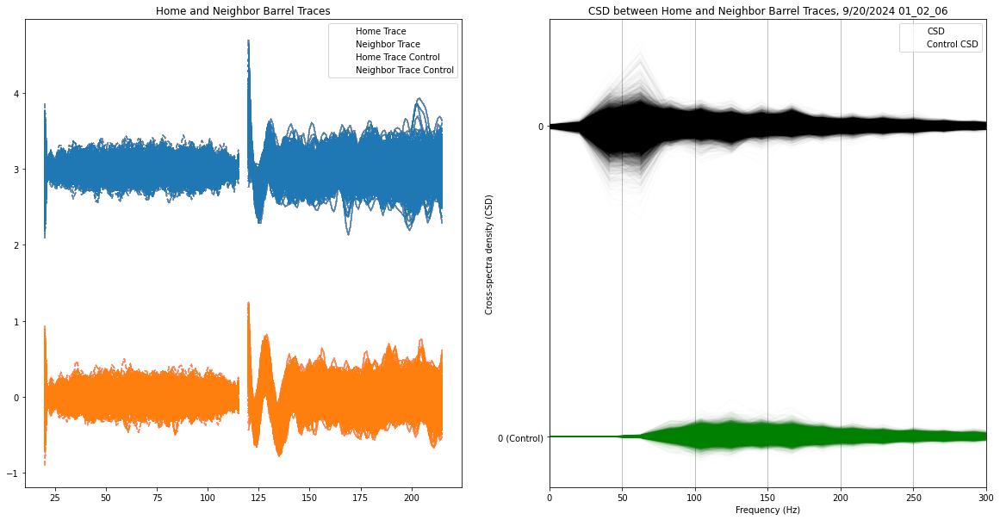

Working on trial 1
Working on home ROI ROI1 for trial 1
Working on home ROI ROI2 for trial 1
Working on home ROI ROI3 for trial 1
Working on home ROI ROI4 for trial 1
Working on home ROI ROI5 for trial 1
Working on home ROI ROI6 for trial 1
Working on home ROI ROI7 for trial 1
Working on home ROI ROI8 for trial 1
Working on home ROI ROI9 for trial 1
Working on home ROI ROI10 for trial 1
Working on home ROI ROI11 for trial 1
Working on home ROI ROI12 for trial 1
Working on home ROI ROI13 for trial 1
Working on home ROI ROI14 for trial 1
Working on home ROI ROI15 for trial 1
Working on home ROI ROI16 for trial 1
Working on home ROI ROI17 for trial 1
Working on home ROI ROI18 for trial 1
Working on home ROI ROI19 for trial 1
Working on home ROI ROI20 for trial 1
Working on home ROI ROI21 for trial 1
Working on home ROI ROI22 for trial 1
Working on home ROI ROI23 for trial 1
Working on home ROI ROI24 for trial 1
Working on home ROI ROI25 for trial 1
Working on home ROI ROI26 for trial 1
Wo

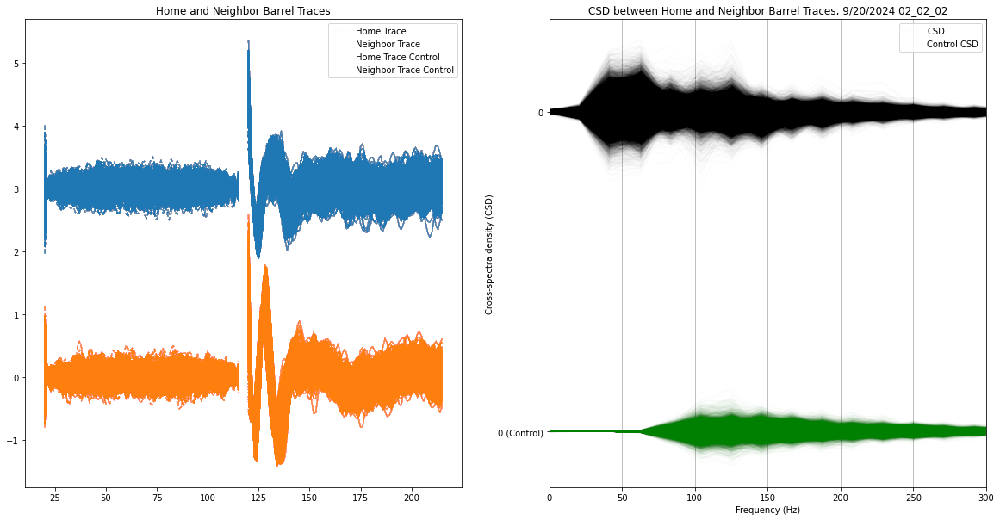

Working on trial 1
Working on home ROI ROI1 for trial 1
Working on home ROI ROI2 for trial 1
Working on home ROI ROI3 for trial 1
Working on home ROI ROI4 for trial 1
Working on home ROI ROI5 for trial 1
Working on home ROI ROI6 for trial 1
Working on home ROI ROI7 for trial 1
Working on home ROI ROI8 for trial 1
Working on home ROI ROI9 for trial 1
Working on home ROI ROI10 for trial 1
Working on home ROI ROI11 for trial 1
Working on home ROI ROI12 for trial 1
Working on home ROI ROI13 for trial 1
Working on home ROI ROI14 for trial 1
Working on home ROI ROI15 for trial 1
Working on home ROI ROI16 for trial 1
Working on home ROI ROI17 for trial 1
Working on home ROI ROI18 for trial 1
Working on home ROI ROI19 for trial 1
Working on home ROI ROI20 for trial 1
Working on home ROI ROI21 for trial 1
Working on home ROI ROI22 for trial 1
Working on home ROI ROI23 for trial 1
Working on home ROI ROI24 for trial 1
Working on home ROI ROI25 for trial 1
Working on home ROI ROI26 for trial 1
Wo

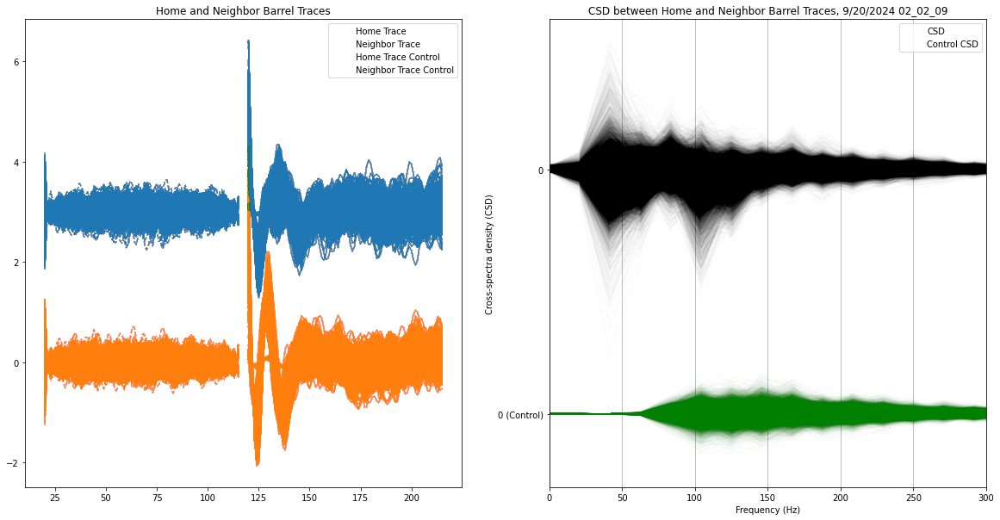

In [12]:
polyfit_order = 11

# disable warnings
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

def get_csd_peak(csd_trace):
    """ Return the peak CSD value. If abs(min(CSD)) is greater than max(CSD), return min(CSD) """
    max_csd = np.max(csd_trace)
    min_csd = np.min(csd_trace)
    if abs(min_csd) > max_csd:
        return min_csd
    return max_csd

# calculate pairwise coherence between all traces 
# barrel_traces_single_px[date][zda_id][which_barrel][i_trial] = {'trace': trace, 'control_trace': control_trace}
for date in barrel_traces_single_px:
    for zda_id in barrel_traces_single_px[date]:

        # calculate coherence for all trials
        trial_coherence = []
        trial_control_coherence = []
        trial_coherence_home_only = []
        trial_control_coherence_home_only = []
        fig, ax = plt.subplots(1, 2, figsize=(20, 10))

        roi_centers_home = barrel_traces_single_px[date][zda_id]['Home'][1]['roi_centers']
        roi_centers_neighbor = barrel_traces_single_px[date][zda_id]['Neighbor'][1]['roi_centers']

        for i_trial in barrel_traces_single_px[date][zda_id]['Home']:

            print("Working on trial " + str(i_trial))
            
            traces_home_orig = barrel_traces_single_px[date][zda_id]['Home'][i_trial]['trace_orig']
            traces_neighbor_orig = barrel_traces_single_px[date][zda_id]['Neighbor'][i_trial]['trace_orig']

            traces_home_mw = barrel_traces_single_px[date][zda_id]['Home'][i_trial]['trace_mw']
            control_traces_home_mw = barrel_traces_single_px[date][zda_id]['Home'][i_trial]['control_trace_mw']
            traces_neighbor_mw = barrel_traces_single_px[date][zda_id]['Neighbor'][i_trial]['trace_mw']
            control_traces_neighbor_mw = barrel_traces_single_px[date][zda_id]['Neighbor'][i_trial]['control_trace_mw']

            # calculate coherence for home and neighbor traces
            n = len(traces_home_orig.columns)-1
            m = len(traces_neighbor_orig.columns)-1
            roi_coherence = np.zeros((n,m))
            roi_control_coherence = np.zeros((n,m))
            roi_coherence_home_only = np.zeros((n,m))
            roi_control_coherence_home_only = np.zeros((n,m))

            for roi_idx_home in traces_home_orig.columns:
                if 'Pt' == roi_idx_home:
                    continue
                print("Working on home ROI " + roi_idx_home + " for trial " + str(i_trial))

                traces_home_orig1 = traces_home_orig.copy()
                traces_home_orig2 = traces_home_orig.copy()

                traces_home_exclusion_window = []
                # make these exclusion windows everywhere except the measure window
                traces_home_exclusion_window.append([0, traces_home_mw[0]])
                traces_home_exclusion_window.append([traces_home_mw[1], len(traces_home_orig1)])

                control_traces_home_exclusion_window = []
                # make these exclusion windows everywhere except the CONTROL measure window
                control_traces_home_exclusion_window.append([0, control_traces_home_mw[0]])
                control_traces_home_exclusion_window.append([control_traces_home_mw[1], len(traces_home_orig1)])

                # baseline correct the home traces
                bc = BaselineCorrection(traces_home_orig1, 
                                                exclusion_windows=traces_home_exclusion_window, 
                                                polyorder=polyfit_order)
                bc_control = BaselineCorrection(traces_home_orig2, 
                                                exclusion_windows=control_traces_home_exclusion_window, 
                                                polyorder=polyfit_order)
                # apply polynomial fit to the traces for baseline correction
                trace_home_bc = bc.fit_baseline(roi_idx_home)
                control_trace_home_bc = bc_control.fit_baseline(roi_idx_home)

                # apply measure windows
                trace_home_bc = trace_home_bc[traces_home_mw[0]:traces_home_mw[1]]
                control_trace_home_bc = control_trace_home_bc[control_traces_home_mw[0]:control_traces_home_mw[1]]

                # shorten the traces to the same length as control traces
                trace_home_bc = trace_home_bc[:len(control_trace_home_bc)]
                
                for roi_idx_neighbor in traces_neighbor_orig.columns:
                    if 'Pt' == roi_idx_neighbor:
                        continue

                    traces_neighbor_orig1 = traces_neighbor_orig.copy()
                    traces_neighbor_orig2 = traces_neighbor_orig.copy()

                    traces_neighbor_exclusion_windows = []
                    # make these exclusion windows everywhere except the measure window
                    traces_neighbor_exclusion_windows.append([0, traces_neighbor_mw[0]])
                    traces_neighbor_exclusion_windows.append([traces_neighbor_mw[1], len(traces_neighbor_orig1)])

                    traces_neighbor_exclusion_windows_control = []
                    # make these exclusion windows everywhere except the CONTROL measure window
                    traces_neighbor_exclusion_windows_control.append([0, control_traces_neighbor_mw[0]])
                    traces_neighbor_exclusion_windows_control.append([control_traces_neighbor_mw[1], len(traces_neighbor_orig1)])

                    bc = BaselineCorrection(traces_neighbor_orig1, 
                                                    exclusion_windows=traces_neighbor_exclusion_windows, 
                                                    polyorder=polyfit_order)
                    bc_control = BaselineCorrection(traces_neighbor_orig2, 
                                                    exclusion_windows=traces_neighbor_exclusion_windows_control, 
                                                    polyorder=polyfit_order)
                    # apply polynomial fit to the traces for baseline correction
                    trace_neighbor_bc = bc.fit_baseline(roi_idx_neighbor)
                    control_trace_neighbor_bc = bc_control.fit_baseline(roi_idx_neighbor)

                    # apply measure windows
                    trace_neighbor_bc = trace_neighbor_bc[traces_neighbor_mw[0]:traces_neighbor_mw[1]]
                    control_trace_neighbor_bc = control_trace_neighbor_bc[control_traces_neighbor_mw[0]:control_traces_neighbor_mw[1]]

                    # show the bc
                    # bc.corrected_trace_with_baseline_plot(roi_idx_neighbor)

                    # shorten the traces to the same length as control traces
                    trace_neighbor_bc = trace_neighbor_bc[:len(control_trace_neighbor_bc)]


                    # subtract polyfit baseline from traces and control traces and find the coherence or CSD
                    f, Cxy = csd(trace_home_bc, trace_neighbor_bc, 
                                fs=2000)
                    f_control, Cxy_control = csd(control_trace_home_bc, 
                                                    control_trace_neighbor_bc, 
                                                    fs=2000)

                    # plot the coherence vs frequency
                    m1 = ax[1].plot(f, Cxy, label='Coherence', color='black', alpha=0.01)
                    m2 = ax[1].plot(f_control, Cxy_control - 0.005, label='Control Coherence', color='green', alpha=0.01)
                    
                    # plot the home and neighbor traces
                    l1_0 = ax[0].plot(trace_home_bc+3, label='Home Trace', color='tab:blue', alpha=0.01)
                    l2_0 = ax[0].plot(trace_neighbor_bc, label='Neighbor Trace', color='tab:orange', alpha=0.01)
                    l1_control = ax[0].plot(control_trace_home_bc+3, label='Home Trace Control', linestyle='--', color='tab:blue', alpha=0.01)
                    l2_control = ax[0].plot(control_trace_neighbor_bc, label='Neighbor Trace Control', linestyle='--', color='tab:orange', alpha=0.01)

                    # take the peak coherence value
                    aggregate_coherence = get_csd_peak(Cxy)  
                    aggregate_control_coherence = get_csd_peak(Cxy_control)

                    i_home = int(roi_idx_home.split("ROI")[-1]) - 1
                    i_neighbor = int(roi_idx_neighbor.split("ROI")[-1]) - 1
                    roi_coherence[i_home][i_neighbor] = aggregate_coherence
                    roi_control_coherence[i_home][i_neighbor] = aggregate_control_coherence

                '''# correlate between ROIs in the home barrel
                for roi_idx_home_2 in traces_home_orig.columns:
                    if 'Pt' == roi_idx_home_2 or 'Pt' == roi_idx_home:
                        continue
                    trace_home_2 = traces_home_orig[roi_idx_home_2].values
                    control_trace_home_2 = control_traces_home[roi_idx_home_2].values

                    # shorten the traces to the same length as control traces
                    trace_home_2 = trace_home_2[:len(control_trace_home_2)]

                    Cxy = correlate(trace_home, trace_home_2)
                    Cxy_control = correlate(control_trace_home, control_trace_home_2)
                    average_coherence = np.mean(Cxy)
                    average_control_coherence = np.mean(Cxy_control)

                    i_home = int(roi_idx_home.split("ROI")[-1]) - 1
                    i_home_2 = int(roi_idx_home_2.split("ROI")[-1]) - 1
                    roi_coherence_home_only[i_home][i_home_2] = average_coherence
                    roi_control_coherence_home_only[i_home][i_home_2] = average_control_coherence'''

            trial_coherence.append(roi_coherence)
            trial_control_coherence.append(roi_control_coherence)
            trial_coherence_home_only.append(roi_coherence_home_only)
            trial_control_coherence_home_only.append(roi_control_coherence_home_only)
        ax[1].set_title('CSD between Home and Neighbor Barrel Traces, ' + date + " " + zda_id)
        ax[1].set_xlabel('Frequency (Hz)')
        ax[1].set_ylabel('Cross-spectra density (CSD)')
        ax[1].set_xlim(0, 300)
        ax[1].set_yticks([])
        # put two y-ticks at 0 and -0.005 and label them 0 and 0 (control)
        ax[1].set_yticks([0, -0.005])
        ax[1].set_yticklabels(['0', '0 (Control)'])
        #ax[1].set_ylim(0, 0.01)
        ax[1].grid()
        ax[1].legend(handles=[m1[0], m2[0]], labels=['CSD', 'Control CSD'])
        ax[0].set_title('Home and Neighbor Barrel Traces')
        ax[0].legend(handles=[l1_0[0], l2_0[0], l1_control[0], l2_control[0]], 
                    labels=['Home Trace', 'Neighbor Trace', 'Home Trace Control', 'Neighbor Trace Control'])
        plt.savefig(data_dir + date.replace("/", "-") + '_' + zda_id + '_CSD.png')
        plt.show()

        # calculate the average coherence for all trials
        #print(np.array(trial_coherence).shape)
        average_coherence = np.mean(np.array(trial_coherence), axis=0)
        average_control_coherence = np.mean(np.array(trial_control_coherence), axis = 0)
        average_coherence_home_only = np.mean(np.array(trial_coherence_home_only), axis=0)
        average_control_coherence_home_only = np.mean(np.array(trial_control_coherence_home_only), axis=0)

        # save average coherence matrix
        barrel_traces_single_px[date][zda_id]['CSD'] = average_coherence
        barrel_traces_single_px[date][zda_id]['Control_CSD'] = average_control_coherence
        barrel_traces_single_px[date][zda_id]['CSD_Home_Only'] = average_coherence_home_only
        barrel_traces_single_px[date][zda_id]['Control_CSD_Home_Only'] = average_control_coherence_home_only


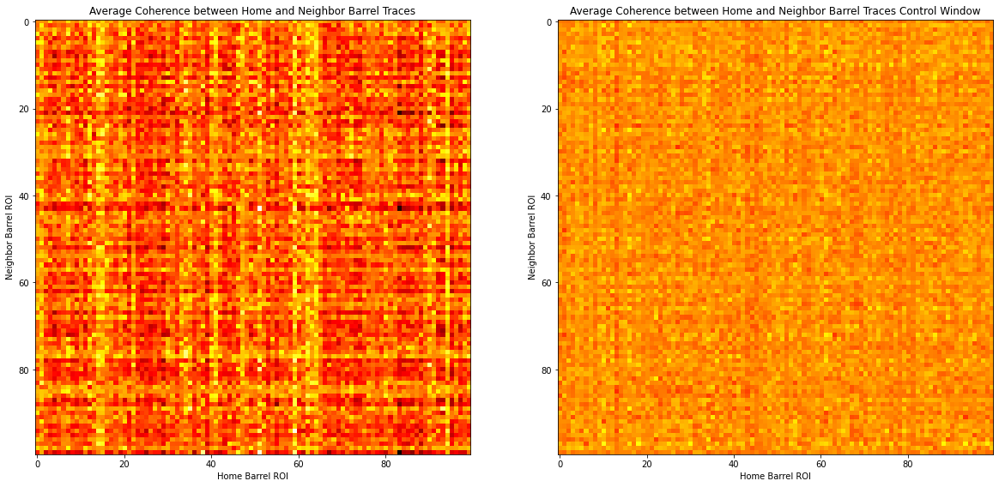

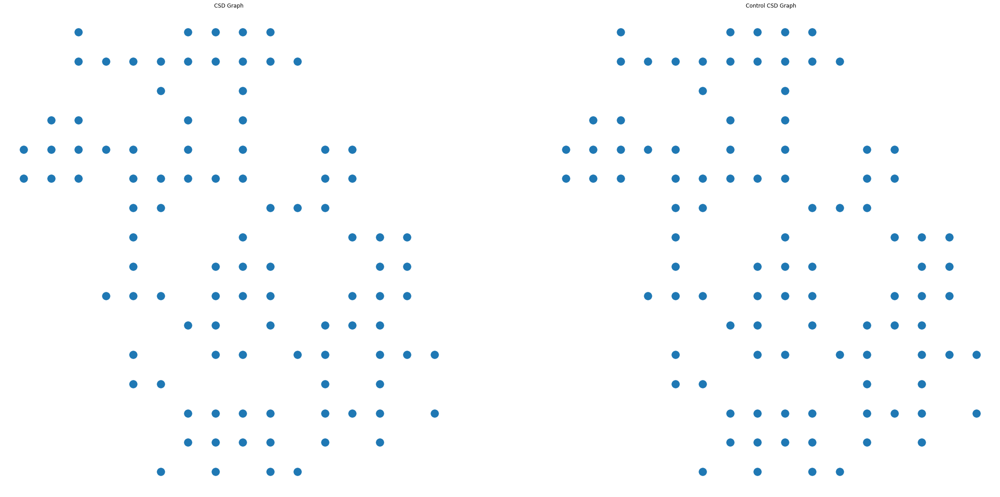



****** Graph Theory Metrics ******
Average Degree of CSD Graph: 19.16
Average Degree of Control CSD Graph: 18.96
Average Clustering Coefficient of CSD Graph: 0.26345612202188173
Average Clustering Coefficient of Control CSD Graph: 0.24211263660398916
Average Shortest Path Length of CSD Graph: 1.8874747474747475
Average Shortest Path Length of Control CSD Graph: 1.8761616161616161


AttributeError: module 'networkx.algorithms' has no attribute 'find_negative_cycle'

In [23]:
# function to create node colour list
def create_community_node_colors(graph, communities):
    number_of_colors = len(communities)
    colors = ["#D4FCB1", "#CDC5FC", "#FFC2C4", "#F2D140", "#BCC6C8"][:number_of_colors]
    node_colors = []
    for node in graph:
        current_community_index = 0
        for community in communities:
            if node in community:
                node_colors.append(colors[current_community_index])
                break
            current_community_index += 1
    return node_colors


# function to plot graph with node colouring based on communities
def visualize_communities(graph, communities, i):
    node_colors = create_community_node_colors(graph, communities)
    modularity = round(nx.community.modularity(graph, communities), 6)
    title = f"Community Visualization of {len(communities)} communities with modularity of {modularity}"
    pos = nx.spring_layout(graph, k=0.3, iterations=50, seed=2)
    plt.subplot(3, 1, i)
    plt.title(title)
    nx.draw(
        graph,
        pos=pos,
        node_size=1000,
        node_color=node_colors,
        with_labels=True,
        font_size=20,
        font_color="black",
    )

for date in barrel_traces_single_px:
    for zda_id in barrel_traces_single_px[date]:

        average_coherence = barrel_traces_single_px[date][zda_id]['CSD']
        average_control_coherence = barrel_traces_single_px[date][zda_id]['Control_CSD']
        average_coherence_home_only = barrel_traces_single_px[date][zda_id]['CSD_Home_Only']
        average_control_coherence_home_only = barrel_traces_single_px[date][zda_id]['Control_CSD_Home_Only']

        roi_centers_home = barrel_traces_single_px[date][zda_id]['Home'][1]['roi_centers']
        roi_centers_neighbor = barrel_traces_single_px[date][zda_id]['Neighbor'][1]['roi_centers']

        # plot the average coherence as a heatmap
        fig, ax = plt.subplots(1, 2, figsize=(20, 10))
        min_co = min(np.min(average_coherence), np.min(average_control_coherence),
                     np.min(average_coherence_home_only), np.min(average_control_coherence_home_only))
        max_co = max(np.max(average_coherence), np.max(average_control_coherence),
                     np.max(average_coherence_home_only), np.max(average_control_coherence_home_only)) 
        ax[0].imshow(average_coherence, cmap='hot', interpolation='nearest', vmin=min_co, vmax=max_co)
        ax[0].set_title('Average Coherence between Home and Neighbor Barrel Traces')
        ax[0].set_xlabel('Home Barrel ROI')
        ax[0].set_ylabel('Neighbor Barrel ROI')
        
        ax[1].imshow(average_control_coherence, cmap='hot',  interpolation='nearest', vmin=min_co, vmax=max_co)
        ax[1].set_title('Average Coherence between Home and Neighbor Barrel Traces Control Window')
        ax[1].set_xlabel('Home Barrel ROI')
        ax[1].set_ylabel('Neighbor Barrel ROI')

        '''ax1[0].imshow(average_coherence_home_only, cmap='hot', interpolation='nearest', vmin=min_co, vmax=max_co)
        ax1[0].set_title('Average Coherence between Home Barrel Traces')
        ax1[0].set_xlabel('Home Barrel ROI')
        ax1[0].set_ylabel('Home Barrel ROI')

        ax1[1].imshow(average_control_coherence_home_only, cmap='hot', interpolation='nearest', vmin=min_co, vmax=max_co)
        ax1[1].set_title('Average Coherence between Home Barrel Traces Control Window')
        ax1[1].set_xlabel('Home Barrel ROI')
        ax1[1].set_ylabel('Home Barrel ROI')'''
        plt.savefig(data_dir + date.replace("/", "-") + '_' + zda_id + '_CSD_Peak_array.png')
        plt.show()

        # graph theory metrics.
        G_csd = nx.Graph()
        G_control_csd = nx.Graph()

        # add nodes, filtering the CSD or "coherence matrixes" to only include the top 5% or bottom 5% of values
        # in the coherence matrix
        threshold = np.percentile(average_coherence, 95)
        threshold_control = np.percentile(average_control_coherence, 95)
        threshold_lower = np.percentile(average_coherence, 5)
        threshold_control_lower = np.percentile(average_control_coherence, 5)
        
        for i in range(average_coherence.shape[0]):
            for j in range(average_coherence.shape[1]):
                if average_coherence[i][j] > threshold or average_coherence[i][j] < threshold_lower:
                    G_csd.add_edge(i, j, weight=average_coherence[i][j])
                if average_control_coherence[i][j] > threshold_control or average_control_coherence[i][j] < threshold_control_lower:
                    G_control_csd.add_edge(i, j, weight=average_control_coherence[i][j])

        # use roi_centers to create a visualization of the CSD matrix, plotting edges between ROIs 
        fig, ax = plt.subplots(1, 2, figsize=(40, 20))
        pos = {i: roi_centers_home[i] for i in range(len(roi_centers_home))}
        pos_control = {i: roi_centers_home[i] for i in range(len(roi_centers_home))}
        nx.draw(G_csd, pos, ax=ax[0], with_labels=False)
        ax[0].set_title('CSD Graph')
        nx.draw(G_control_csd, pos_control, ax=ax[1], with_labels=False)
        ax[1].set_title('Control CSD Graph')
        plt.savefig(data_dir + date.replace("/", "-") + '_' + zda_id + '_CSD_Graph_edge_visual.png')
        plt.show()


        # calculate the average degree of the graph
        print("\n\n****** Graph Theory Metrics ******")
        avg_degree = np.mean([d for n, d in G_csd.degree()])
        avg_degree_control = np.mean([d for n, d in G_control_csd.degree()])
        print("Average Degree of CSD Graph: " + str(avg_degree))
        print("Average Degree of Control CSD Graph: " + str(avg_degree_control))

        # calculate the average clustering coefficient
        avg_clustering = nx.average_clustering(G_csd)
        avg_clustering_control = nx.average_clustering(G_control_csd)
        print("Average Clustering Coefficient of CSD Graph: " + str(avg_clustering))
        print("Average Clustering Coefficient of Control CSD Graph: " + str(avg_clustering_control))

        # calculate the average shortest path length
        avg_shortest_path = nx.average_shortest_path_length(G_csd)
        avg_shortest_path_control = nx.average_shortest_path_length(G_control_csd)
        print("Average Shortest Path Length of CSD Graph: " + str(avg_shortest_path))
        print("Average Shortest Path Length of Control CSD Graph: " + str(avg_shortest_path_control))

        # check for negative cycles of odd length
        n_negative_odd_cycles = 0
        try:
            negative_cycles = nx.find_negative_cycle(G_csd)
            for cycle in negative_cycles:
                n_nodes = len(cycle)
                if n_nodes % 2 == 1:
                    n_negative_odd_cycles += 1
                    break
        except nx.exception.NetworkXNoCycle:
            pass 
        print("Number of Negative Cycles of Odd Length in CSD Graph: " + str(n_negative_odd_cycles))

        # calculate the betweenness centrality and plot the distribution
        betweenness = nx.betweenness_centrality(G_csd)
        betweenness_control = nx.betweenness_centrality(G_control_csd)
        fig, ax = plt.subplots(1, 2, figsize=(20, 10))
        ax[0].hist(betweenness.values(), bins=20)
        ax[0].set_title('Betweenness Centrality Distribution of CSD Graph')
        ax[0].set_xlabel('Betweenness Centrality')
        ax[0].set_ylabel('Count')
        ax[1].hist(betweenness_control.values(), bins=20)
        ax[1].set_title('Betweenness Centrality Distribution of Control CSD Graph')
        ax[1].set_xlabel('Betweenness Centrality')
        ax[1].set_ylabel('Count')
        plt.savefig(data_dir + date.replace("/", "-") + '_' + zda_id + '_Betweenness_Centrality.png')
        plt.show()

        # calculate the modular community structure
        communities = list(nx.community.girvan_newman(G_csd))
        communities_control = list(nx.community.girvan_newman(G_control_csd))
        print("Modular Community Structure of CSD Graph: " + str(communities))
        print("Modular Community Structure of Control CSD Graph: " + str(communities_control))

        # calculate the modularity of the graph
        modularity_df = pd.DataFrame(
            [[k+1, nx.community.modularity(G_csd, communities[k])] for k in range(len(communities))],
            columns=['Community', 'Modularity']
        )
        modularity_control_df = pd.DataFrame(
            [[k+1, nx.community.modularity(G_control_csd, communities_control[k])] for k in range(len(communities_control))],
            columns=['Community', 'Modularity']
        )

        fig, ax = plt.subplots(3, figsize=(15, 20))

        # Plot graph with colouring based on communities
        visualize_communities(G_csd, communities[3], 1)

        # Plot change in modularity as the important edges are removed
        modularity_df.plot.bar(
            x="Community",
            ax=ax[1],
            color="#F2D140",
            title="Modularity Trend for Girvan-Newman Community Detection",
        )
        modularity_control_df.plot.bar(
            x="Community",
            ax=ax[2],
            color="#F2D140",
            title="Modularity Trend for Girvan-Newman Community Detection Control",
        )
        plt.show()

        # visualize the community structure using nx.draw_spring
        node_partition_colors = [communities.get(nd) for nd in G_csd.nodes()]
        node_partition_colors_control = [communities_control.get(nd) for nd in G_control_csd.nodes()]
        nx.draw_spring(G_csd, node_color=node_partition_colors, with_labels=False)
        plt.title('Community Structure of CSD Graph')
        plt.savefig(data_dir + date.replace("/", "-") + '_' + zda_id + '_Community_Structure.png')
        plt.show()

        nx.draw_spring(G_control_csd, node_color=node_partition_colors_control, with_labels=False)
        plt.title('Community Structure of Control CSD Graph')
        plt.savefig(data_dir + date.replace("/", "-") + '_' + zda_id + '_Community_Structure_Control.png')
        plt.show()


